In [6]:
import os
import json

os.environ["PYTORCH_ENABLE_MPS_FALLBACK"] = "1"
os.environ["KMP_DUPLICATE_LIB_OK"] = "TRUE"
import torch

from sklearn.neighbors import KNeighborsClassifier
import numpy as np
from collections import defaultdict
from tqdm import tqdm
from embedder import Embedder
import matplotlib.pyplot as plt
from PIL import Image
from pathlib import Path
from torchvision import transforms

/Users/iman/.local/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [21]:
ROOT_DIR = "/Users/iman/345-data/"
DATA_DIR = Path(ROOT_DIR, "ml-datasets", "telstra")
VECTORS_DIR = Path(DATA_DIR, "vectors")

DATASET = "telstra-20250627"
output_dir = VECTORS_DIR / DATASET
crops_dir = DATA_DIR / "recognition" / DATASET
output_dir.mkdir(parents=True, exist_ok=True)

In [14]:
device = torch.device("mps")

In [15]:
model_root = Path("./model")


embedder = Embedder(model_root / "trunk_weights.pth",
                    model_root / "embedder_weights.pth",device=device)

In [ ]:

to_tensor = transforms.ToTensor()
resize = transforms.Resize((224, 224),interpolation=transforms.InterpolationMode.BILINEAR)
images = [Image.open(img) for img in sorted((crops_dir).rglob("*.jpg"))]
images_tensors = torch.stack([resize(to_tensor(img)) for img in images]).to(device)


In [18]:
images_tensors.shape

torch.Size([3527, 3, 224, 224])

In [28]:
vectors = embedder.embed(images_tensors)

In [20]:
torch.save(vectors, output_dir / "vectors.pt")

In [25]:
image_names = [img.stem for img in sorted((crops_dir).rglob("*.jpg"))]
classes = ["_".join(name.split("_")[:-1]) for name in image_names]
json.dump(classes, open(output_dir / "classes.json", "w"))

In [30]:
ref_vectors = vectors
ref_classes = classes

In [31]:


## need to normalize the supervectors
unique_classes, class_indices = np.unique(np.array(ref_classes), return_inverse=True)
unique_uuids, uuid_indices = np.unique(
    ["_".join(cls.split("_")[:-1]) for cls in ref_classes], return_inverse=True
)
num_of_classes = class_indices[-1] + 1
num_uuids = uuid_indices[-1] + 1
#supervectors = torch.empty((num_of_classes, 256), dtype=ref_vectors.dtype)
supervectors = torch.empty((num_of_classes, 256))
for class_i in tqdm(range(num_of_classes)):
    vectors = ref_vectors[class_indices == class_i]
    supervectors[class_i, :] = torch.mean(vectors, axis=0)

supervectors /= torch.linalg.norm(supervectors, axis=1)[:, torch.newaxis]
superclasses = unique_classes

100%|██████████| 1058/1058 [00:01<00:00, 539.42it/s]


In [ ]:
output_dir

PosixPath('/Users/iman/345-data/ml-datasets/telstra/vectors')

In [ ]:
torch.save(
    supervectors,
    output_dir / "supervectors.pt",
)
with open(
    output_dir / "superclasses.json", "w"
) as f:
    json.dump(superclasses.tolist(), f)

In [17]:
supervectors[0]

tensor([-1.3617e-02, -2.5514e-02,  4.7339e-02,  3.3507e-02,  4.2378e-02,
        -7.6358e-02,  3.4538e-02, -4.5285e-02, -8.4225e-02, -1.3218e-01,
         7.5174e-02,  7.6498e-03,  4.6413e-02, -3.2276e-03, -1.2839e-01,
        -1.0516e-01,  7.0232e-03,  6.0001e-02,  4.9201e-02,  1.7176e-03,
         3.5946e-02, -4.7395e-02,  2.0608e-02, -3.9455e-02,  4.2804e-02,
        -1.2255e-01,  6.0304e-02, -6.1879e-03, -2.2846e-02,  2.6482e-02,
         1.0199e-01, -1.5189e-03, -2.5099e-02,  1.6082e-02, -3.1616e-02,
         1.8949e-02,  1.2028e-02,  5.9505e-03,  6.8521e-02, -2.6290e-02,
        -1.1689e-02, -1.3200e-01, -1.6572e-01,  5.1261e-02, -3.4965e-02,
         1.4190e-01,  1.1141e-01,  1.4295e-03, -9.1345e-03,  7.6835e-02,
         4.6041e-02,  1.3063e-03, -1.2681e-01, -1.2245e-02, -1.6098e-02,
        -5.9070e-02,  3.6381e-02,  1.4604e-02,  5.4434e-02, -8.2243e-02,
        -1.4412e-01,  2.4298e-02,  3.5595e-02,  1.2244e-02, -5.1852e-02,
        -1.2252e-01,  6.4709e-02, -6.1083e-02, -2.4

In [9]:
np.array(ref_classes)[:-1][:22]
np.array(ref_classes)[1:][:22]
(np.array(ref_classes)[:-1] != np.array(ref_classes)[1:])[:22]

array([False, False, False,  True, False, False, False, False, False,
       False, False, False,  True, False, False, False,  True, False,
       False, False, False,  True])

In [10]:
def train_sample_split(vectors, classes, face=None):
    if isinstance(vectors,torch.Tensor):
        vectors = np.array(vectors.cpu().numpy())
        classes = np.array(classes)
    # if face is not None, create a mask for the face, applied to all
    if face is not None:
        vectors, classes = filter_by_face(vectors, classes, face)

    # ## offset elements by 1 so that the last element of each face is not included in training set
    mask = np.concatenate(([False], classes[:-1] != classes[1:]))
    # split the vectors and classes into train and sample sets
    train_vectors = vectors[~mask, :]
    train_classes = classes[~mask]

    sample_vectors = vectors[mask, :]
    sample_classes = classes[mask]

    return train_vectors, train_classes, sample_vectors, sample_classes

def create_face_mask(classes, face):
    if isinstance(face, (tuple, list)):
        return np.array([any(f in label for f in face) for label in classes])
    else:
        return np.array([face in label for label in classes])

def filter_by_face(vectors, classes, face):
    face_mask = np.array([cls.split("_")[-1] == face for cls in classes])
    return vectors[face_mask], np.array(classes)[face_mask]


def face_to_face_dist(vectors, classes,face,ref_face='front'):

    ref_mask = np.array([ref_face in label for label in classes])
    ref_face_vectors = vectors[ref_mask, :]

    side_mask = np.array([face in label for label in classes])
    sides_vectors = vectors[side_mask, :]

    dist = scipy.spatial.distance.cdist(ref_face_vectors,sides_vectors)
    
    return dist

def plot_distances(uuids, threshold, face, num_uuids=5, n_comparisons=5,ref_face='front'):
    # Plot matching examples
    for uuid in uuids[:num_uuids]:  # Show up to n UUIDs per threshold for clarity
        fig, axs = plt.subplots(1, n_comparisons + 1, figsize=(18, 3))
        fig.suptitle(f'UUID: {uuid} (threshold < {threshold})', fontsize=14)
        # Load first front image
        ref_folder = os.path.join(IMGS_DIR,DATASET, f"{uuid}_{ref_face}")
        face_folder = os.path.join(IMGS_DIR,DATASET, f"{uuid}_{face}")

        try:
            ref_images = sorted([f for f in os.listdir(ref_folder) if f.lower().endswith(('.jpg', '.png'))])
            face_images = sorted([f for f in os.listdir(face_folder) if f.lower().endswith(('.jpg', '.png'))])
        except FileNotFoundError:
            continue  # skip if folder is missing

        # Show first front image
        if ref_images:
            with Image.open(os.path.join(ref_folder, ref_images[0])) as img:
                axs[0].imshow(img)
                axs[0].set_title(f"{ref_face}")
        axs[0].axis('off')

        # Show up to 5 back images
        for i in range(1, n_comparisons + 1):
            if i-1 < len(face_images):
                with Image.open(os.path.join(face_folder, face_images[i-1])) as img:
                    axs[i].imshow(img)
                    axs[i].set_title(f"{face} {i}")
            axs[i].axis('off')

        plt.tight_layout()
        plt.show()

In [11]:
# what is the accuracy of knn against original reference vectors?
# what type of knn (weighted etc)
# how many neighbors?

In [12]:
## comparing distances

In [13]:
train_vectors, train_classes, sample_vectors, sample_classes = train_sample_split(
    ref_vectors, ref_classes
)

In [14]:
unique_classes, class_indices = np.unique(np.array(ref_classes), return_inverse=True)
unique_uuids, uuid_indices = np.unique(
    ["_".join(cls.split("_")[:-1]) for cls in ref_classes], return_inverse=True
)
num_of_classes = class_indices[-1] + 1
num_uuids = uuid_indices[-1] + 1

front_mask = np.array(["front" in label for label in ref_classes])
front_vectors = ref_vectors[front_mask, :]
sides_vectors = ref_vectors[~front_mask, :]
front_classes = ref_classes[front_mask]
sides_classes = ref_classes[~front_mask]

distances = []

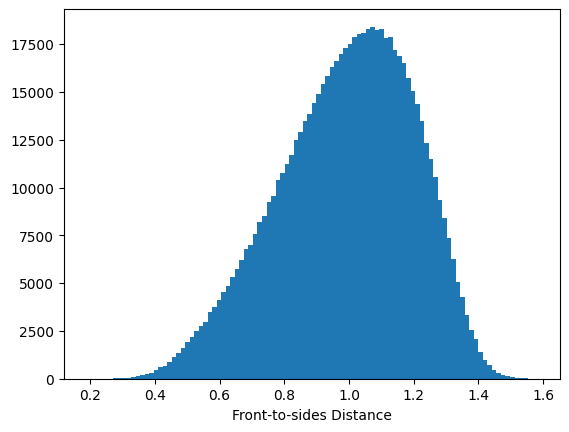

In [23]:
distances = []

for uuid_i in range(num_uuids):
    uuid_mask = uuid_indices == uuid_i
    uuid_vectors = ref_vectors[uuid_mask, :]
    classes = ref_classes[uuid_mask]
    front_mask = np.array(["front" in label for label in classes])
    sides_uuid_vectors = uuid_vectors[~front_mask, :]
    front_uuid_vectors = uuid_vectors[front_mask, :]

    distances.append(
        scipy.spatial.distance.cdist(front_uuid_vectors, sides_uuid_vectors)
    )

flat_dists = np.concatenate([d.flatten() for d in distances])

plt.hist(flat_dists, bins=100)
plt.xlabel("Front-to-sides Distance")
plt.show()

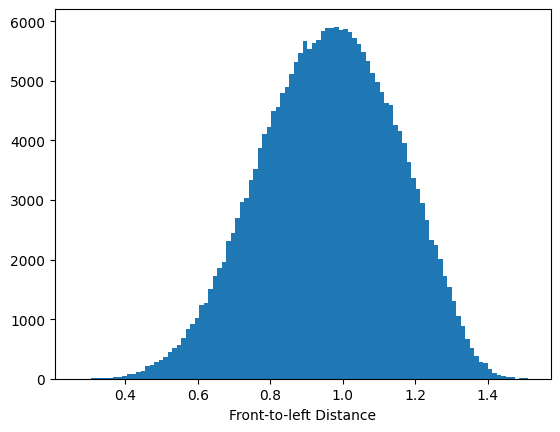

In [24]:
distances = []

for uuid_i in range(num_uuids):
    uuid_mask = uuid_indices == uuid_i
    uuid_vectors = ref_vectors[uuid_mask, :]
    uuid_classes = ref_classes[uuid_mask]
    dist = face_to_face_dist(uuid_vectors, uuid_classes, face="left")

    distances.append(dist)

flat_dists = np.concatenate([d.flatten() for d in distances])

plt.hist(flat_dists, bins=100)
plt.xlabel("Front-to-left Distance")
plt.show()

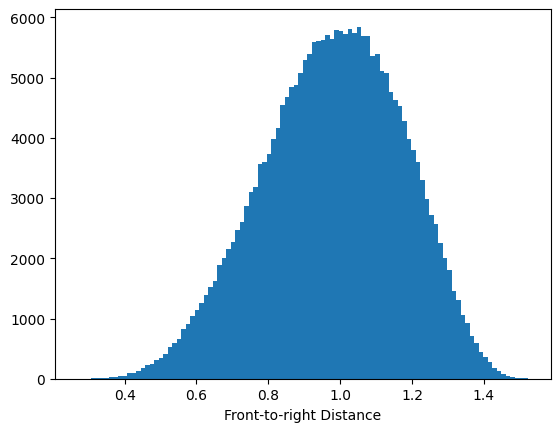

In [25]:
distances = []

for uuid_i in range(num_uuids):
    uuid_mask = uuid_indices == uuid_i
    uuid_vectors = ref_vectors[uuid_mask, :]
    uuid_classes = ref_classes[uuid_mask]
    front_mask = np.array(["front" in label for label in uuid_classes])
    front_uuid_vectors = uuid_vectors[front_mask, :]

    side_mask = np.array(["right" in label for label in uuid_classes])
    sides_uuid_vectors = uuid_vectors[side_mask, :]

    distances.append(
        scipy.spatial.distance.cdist(front_uuid_vectors, sides_uuid_vectors)
    )

flat_dists = np.concatenate([d.flatten() for d in distances])

plt.hist(flat_dists, bins=100)
plt.xlabel("Front-to-right Distance")
plt.show()

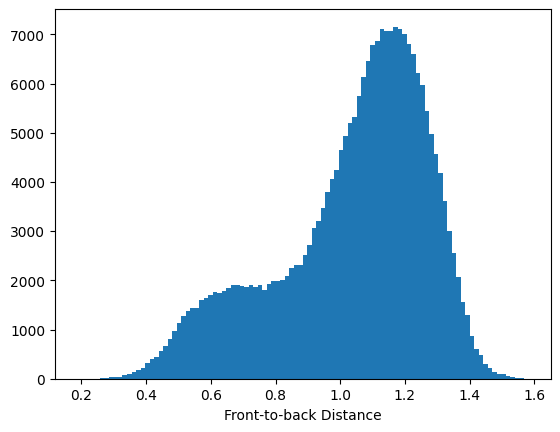

In [26]:
distances = []

for uuid_i in range(num_uuids):
    uuid_mask = uuid_indices == uuid_i
    uuid_vectors = ref_vectors[uuid_mask, :]
    uuid_classes = ref_classes[uuid_mask]
    dist = face_to_face_dist(uuid_vectors, uuid_classes, face="back")
    distances.append(dist)

flat_dists = np.concatenate([d.flatten() for d in distances])

plt.hist(flat_dists, bins=100)
plt.xlabel("Front-to-back Distance")
plt.show()

In [457]:
flat_dists

array([0.        , 0.70888499, 0.64700424, ..., 0.76238599, 0.68440178,
       0.        ])

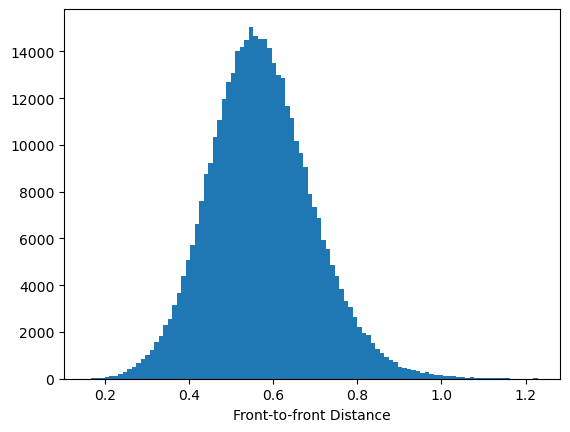

In [16]:
distances = []

for uuid_i in range(num_uuids):
    uuid_mask = uuid_indices == uuid_i
    uuid_vectors = ref_vectors[uuid_mask, :]
    uuid_classes = ref_classes[uuid_mask]
    dist = face_to_face_dist(uuid_vectors, uuid_classes, face="front")
    distances.append(dist)

flat_dists = np.concatenate([d.flatten() for d in distances])
flat_dists = flat_dists[flat_dists > 0]
plt.hist(flat_dists, bins=100)
plt.xlabel("Front-to-front Distance")
plt.show()

In [ ]:
distances = []

for upc in range(num_uuids):
    uuid_mask = uuid_indices == uuid_i
    uuid_vectors = ref_vectors[uuid_mask, :]
    uuid_classes = ref_classes[uuid_mask]
    dist = face_to_face_dist(uuid_vectors, uuid_classes, face="front")
    print(np.argwhere(dist))
    distances.append(dist)

flat_dists = np.concatenate([d.flatten() for d in distances])
flat_dists = flat_dists[flat_dists > 0]
plt.hist(flat_dists, bins=100)
plt.xlabel("Front-to-front Distance")
plt.show()

In [ ]:
face_to_face_dist(ref_vectors, ref_classes, face="front")

In [95]:
os.makedirs(os.path.join(IMGS_DIR, "close fronts"), exist_ok=True)
os.makedirs(os.path.join(IMGS_DIR, "close fronts", "diff upc diff uuid"), exist_ok=True)
os.makedirs(os.path.join(IMGS_DIR, "close fronts", "diff uuid same upc"), exist_ok=True)

In [196]:
import matplotlib.pyplot as plt
import os
import urllib.request


def retrieve_2d_render_from_product_dict(product_dict, uuid):
    product = product_dict[uuid]
    name = product["name"]
    image = [im for im in product["planogramImages"] if im["face"] == 1][0]
    url = f"{image['baseUrl']}/{image['folder']}/{image['fileHashMd5']}.{image['ext']}"
    img, _ = urllib.request.urlretrieve(url, "output.jpg")
    return img, name


def plot_close_pairs(pairs, vectors, classes):
    """
    Plots image pairs where distance between their embeddings is below threshold.

    Args:
        pairs: List of (i, j) tuples with low distances (indices into ref_vectors).
        uuids: List of UUIDs corresponding to ref_vectors (same order).
        face: Face folder name to load images from.
        max_pairs: Max number of pairs to visualize.
    """
    pairs_set = set()
    for idx, (i, j) in enumerate(pairs):
        dist = scipy.spatial.distance.euclidean(vectors[i], vectors[j])
        class_i = classes[i]
        class_j = classes[j]
        uuid_i = class_i.split("_")[0]
        uuid_j = class_j.split("_")[0]
        upc_i = class_i.split("_")[1]
        upc_j = class_j.split("_")[1]

        if upc_i == upc_j and (uuid_i not in pairs_set or uuid_j not in pairs_set):
            pairs_set.add(uuid_i)
            pairs_set.add(uuid_j)
            try:
                img_i, name_i = retrieve_2d_render_from_product_dict(
                    product_dict, uuid_i
                )
                img_j, name_j = retrieve_2d_render_from_product_dict(
                    product_dict, uuid_j
                )
            except (FileNotFoundError, IndexError):
                continue  # skip missing data
            fig, axs = plt.subplots(1, 2, figsize=(10, 4), facecolor=(1, 1, 1, 0))
            if upc_i == upc_j:
                fig.suptitle(f"{upc_i}, distance: {dist:.3f}", fontsize=12)
            else:
                fig.suptitle(f"{upc_i} ↔ {upc_j}", fontsize=12)
            with Image.open(img_i) as im1:
                axs[0].imshow(im1)
                axs[0].axis("off")
                axs[0].set_title(f"{uuid_i}\n{name_i}", fontsize=9)
                axs[0].set_xlabel(name_i, fontsize=8)

            with Image.open(img_j) as im2:
                axs[1].imshow(im2)
                axs[1].axis("off")
                axs[1].set_title(f"{uuid_j}\n{name_j}", fontsize=9)

            save_dir = os.path.join(IMGS_DIR, "close fronts")
            os.makedirs(save_dir, exist_ok=True)
            plt.tight_layout()
            plt.savefig(os.path.join(save_dir, f"{upc_i}_{dist:.3f}.png"), dpi=300)
            plt.show()

In [163]:
# Visualize
with open(os.path.join(DATA_DIR, "CCBF-ProductsToIgnore.json")) as f:
    ignore = json.load(f)

ignore_uuids = [entry["UUID"] for entry in ignore]

ignore_mask = np.array([uuid.split("_")[0] in ignore_uuids for uuid in ref_classes])
filtered_vectors = ref_vectors[~ignore_mask, :]
filtered_classes = ref_classes[~ignore_mask]

face_mask = np.array(["front" in label for label in filtered_classes])

dist = scipy.spatial.distance.cdist(
    filtered_vectors[face_mask, :], filtered_vectors[face_mask, :]
)

Threshold: 0.1
Threshold: 0.2
Threshold: 0.3
Threshold: 0.4


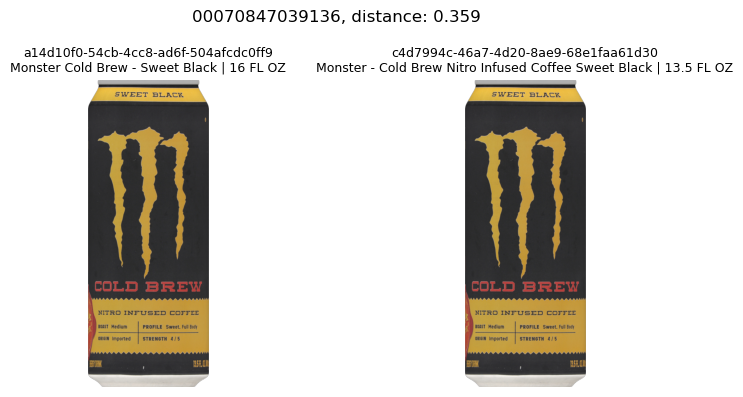

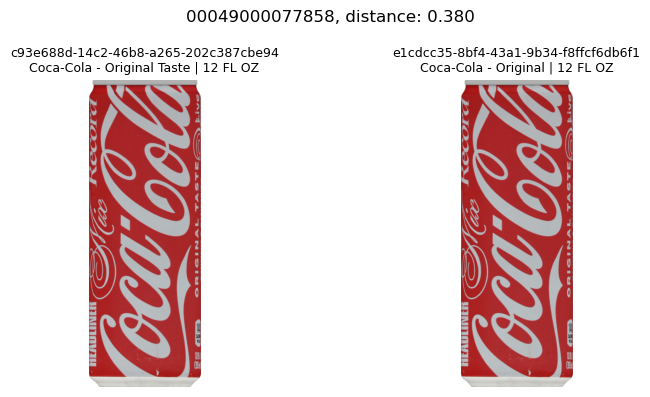

Threshold: 0.5


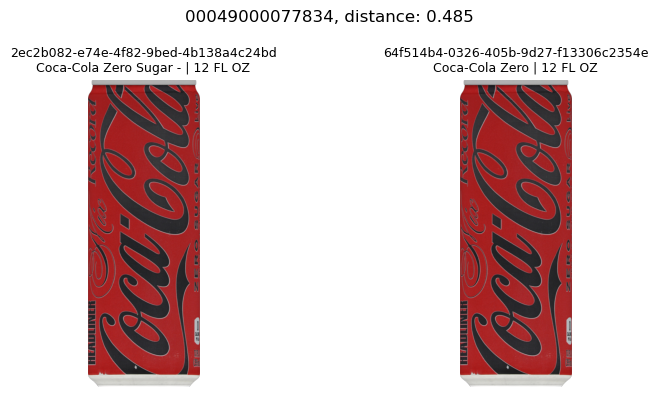

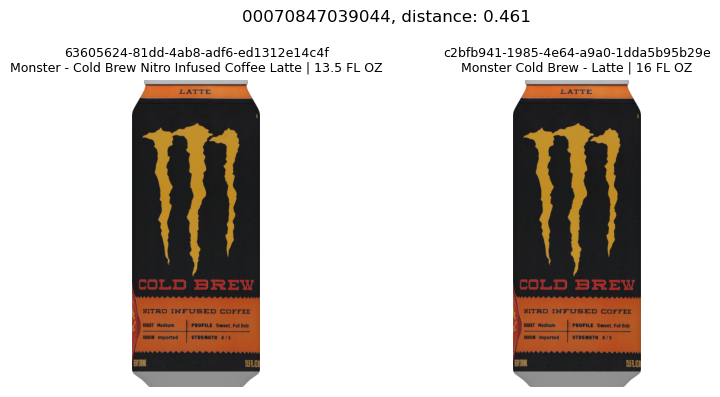

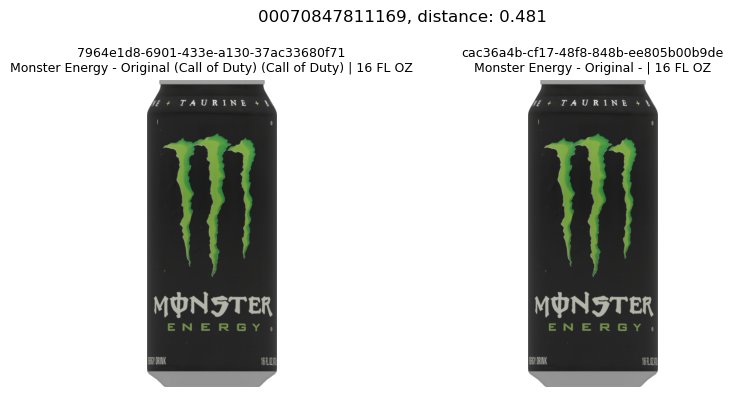

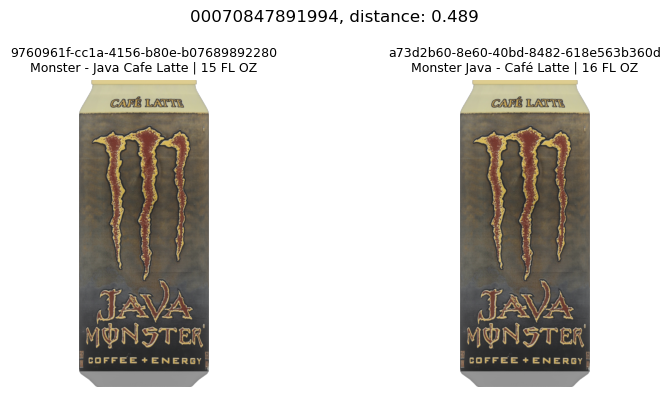

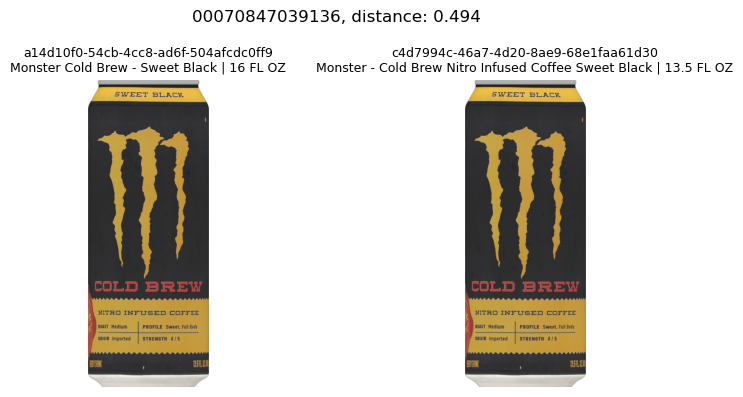

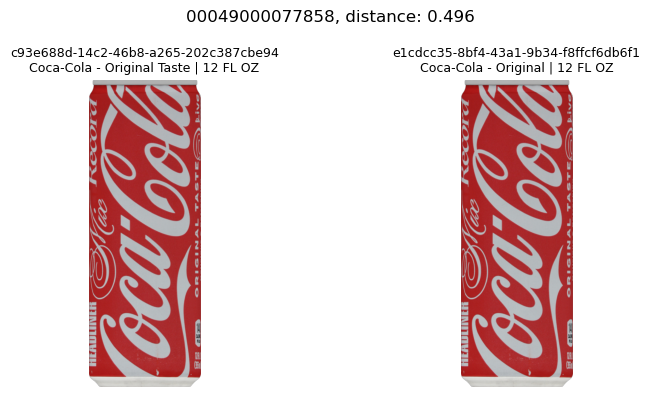

Threshold: 0.6


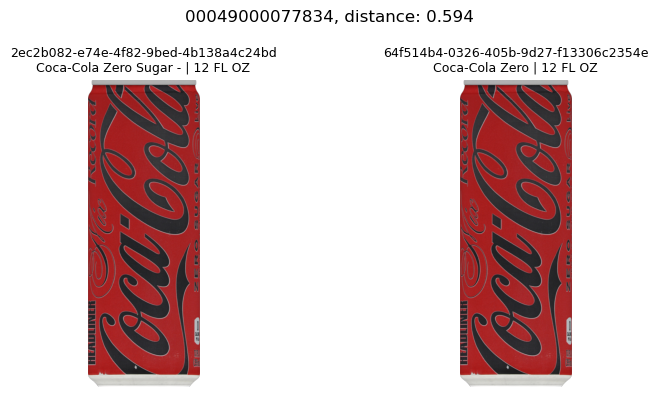

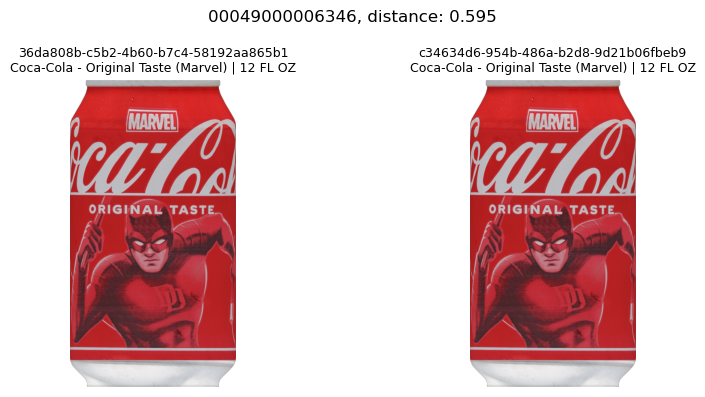

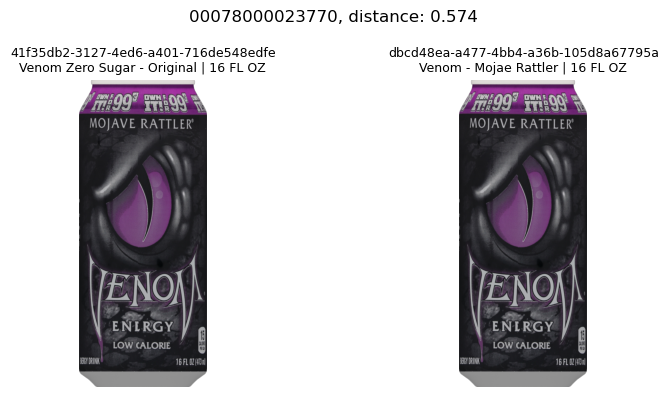

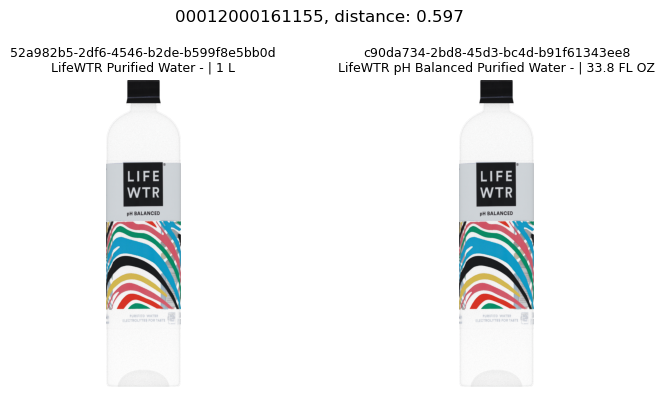

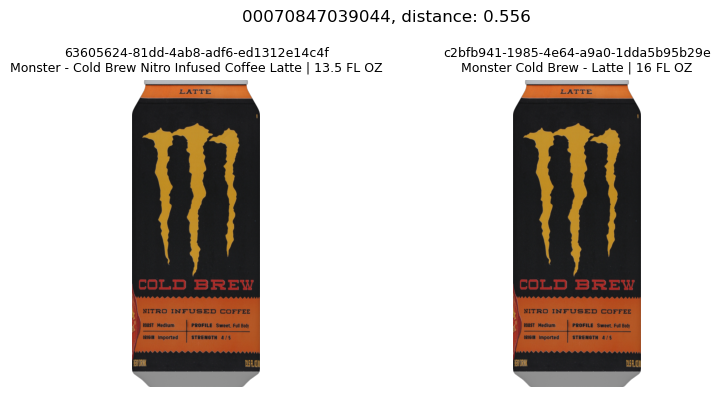

...

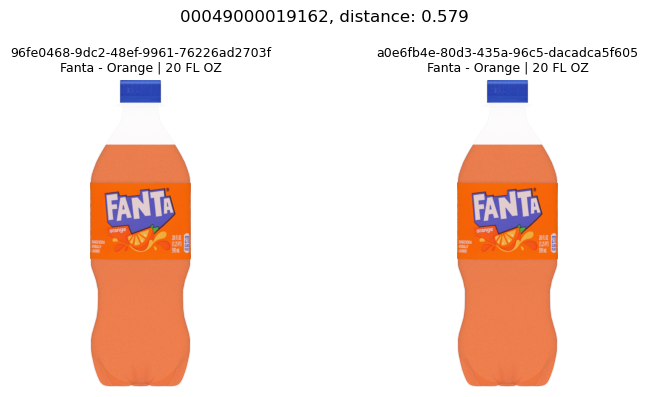

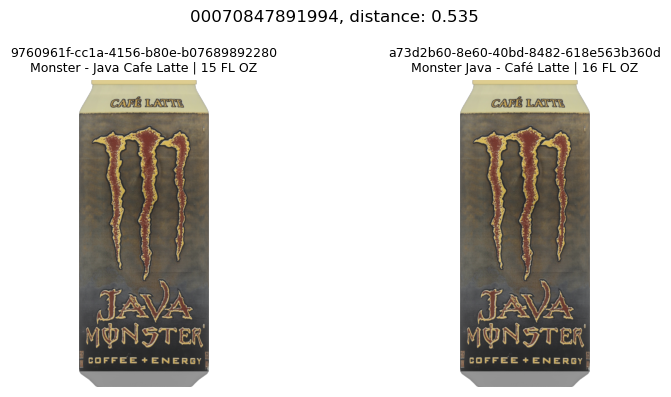

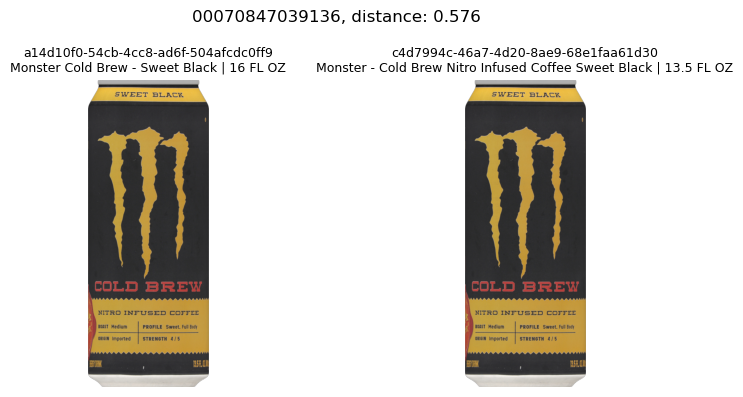

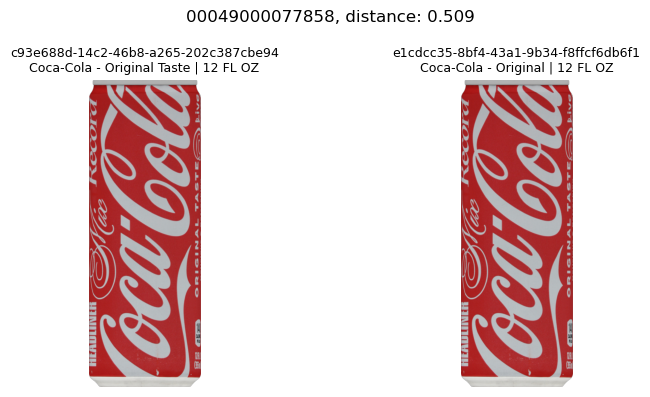

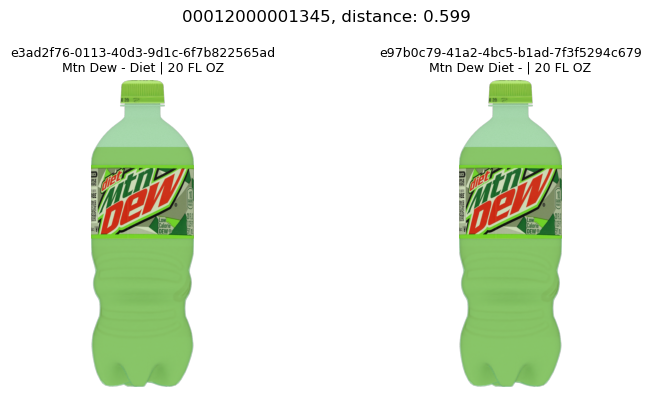

In [198]:
prev_threshold = 0.0
for threshold in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6]:
    print(f"Threshold: {threshold}")
    # Get indices where distance < 0.5 (and not self-comparison)
    i, j = np.where((dist < threshold) & (dist > 0) & (dist > prev_threshold))
    face_indices = np.where(face_mask)[0]
    # Map back to original indices
    original_pairs = [
        (face_indices[x], face_indices[y])
        for x, y in zip(i, j)
        if filtered_classes[face_indices[x]] != filtered_classes[face_indices[y]]
    ]
    unique_pairs = [(a, b) for a, b in original_pairs if a < b]
    plot_close_pairs(unique_pairs, filtered_vectors, filtered_classes)
    prev_threshold = threshold

Threshold:  0.5


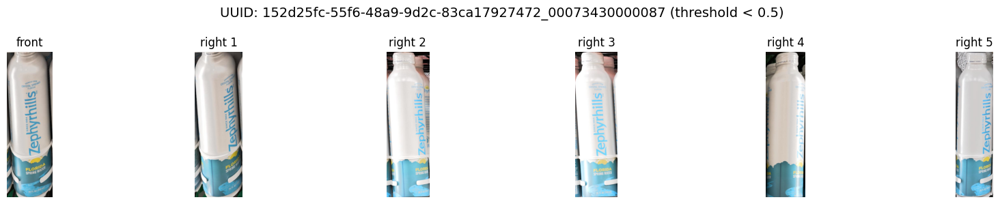

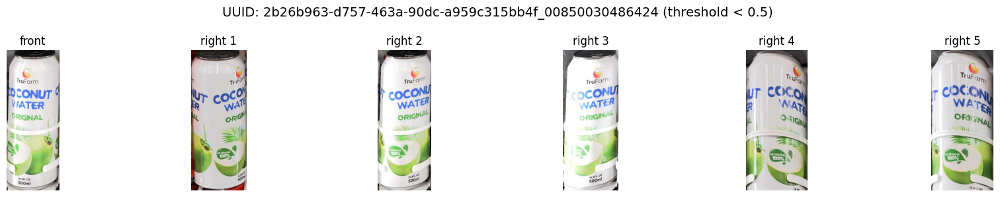

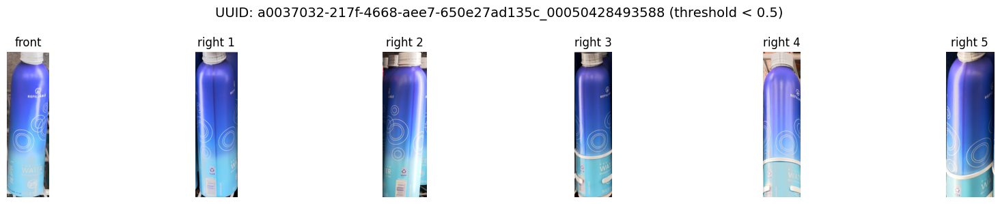

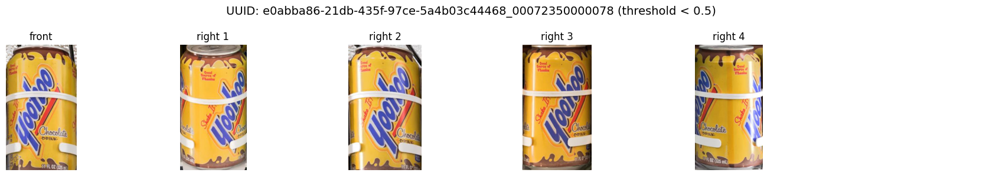

Threshold:  0.6


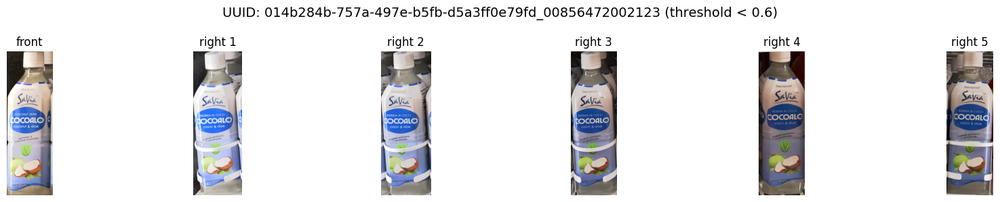

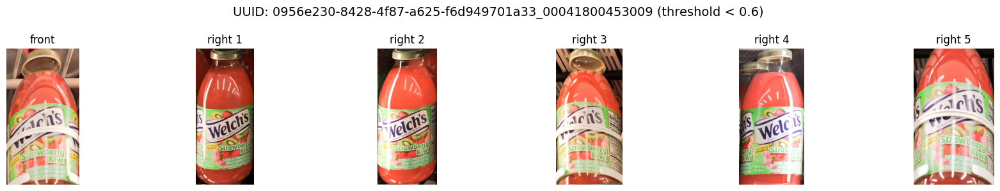

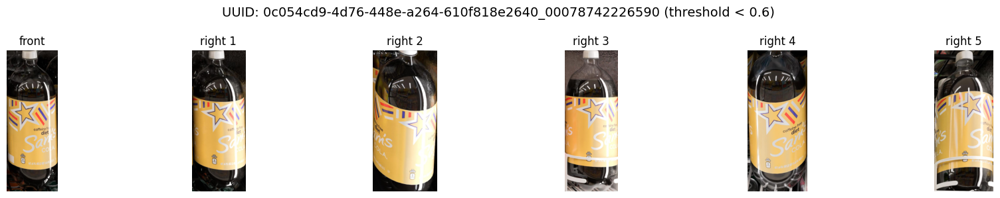

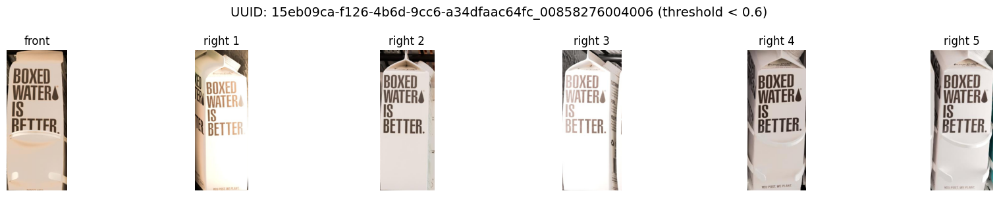

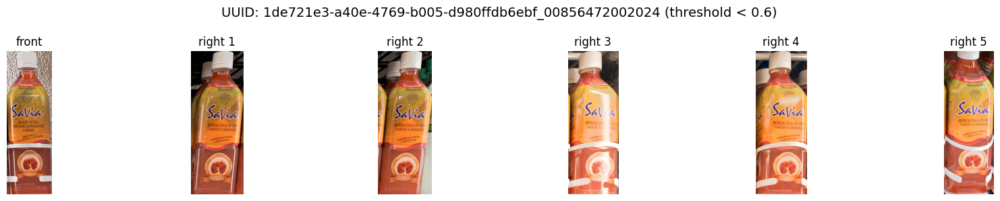

Threshold:  0.7


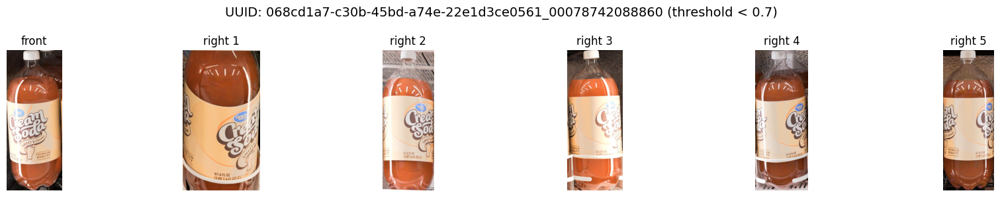

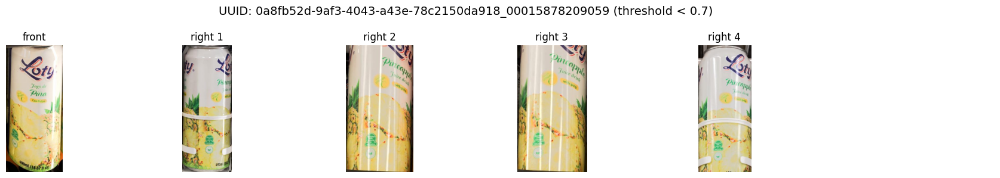

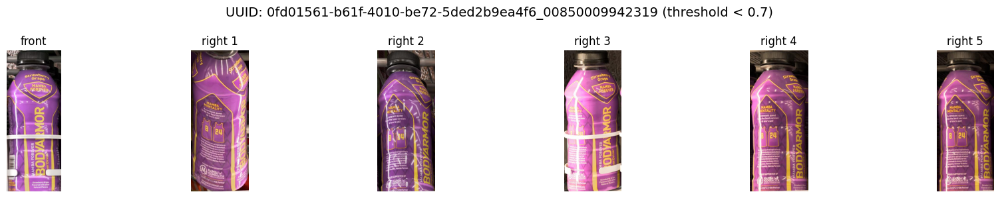

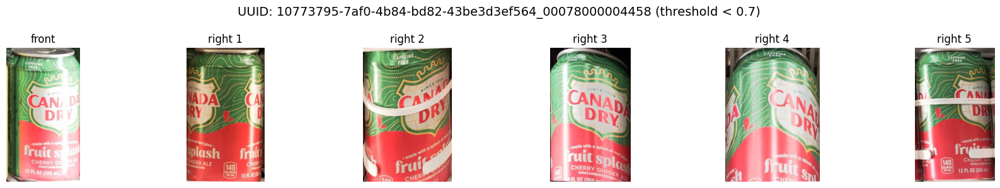

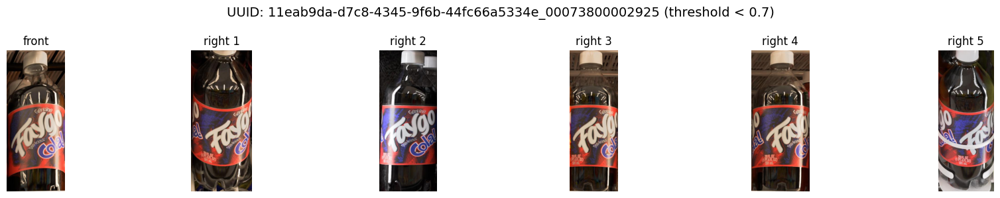

Threshold:  0.8


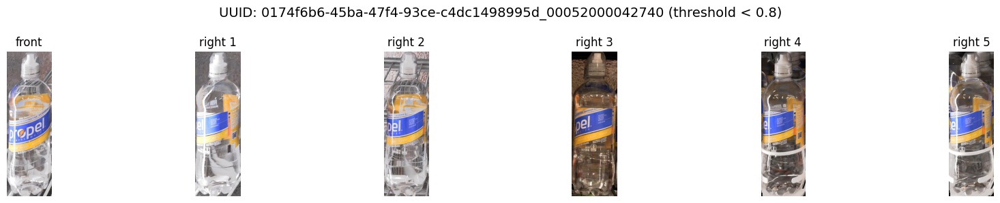

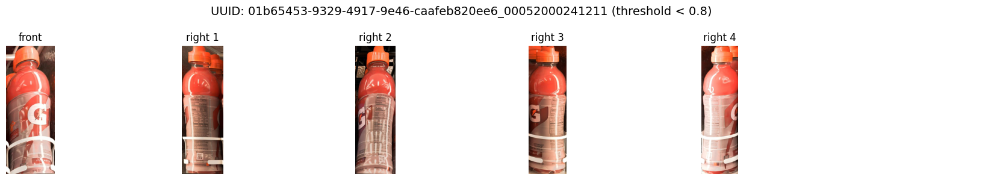

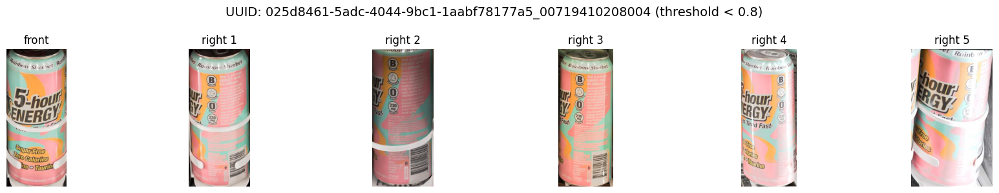

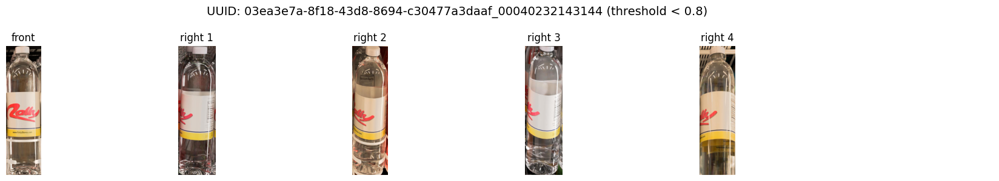

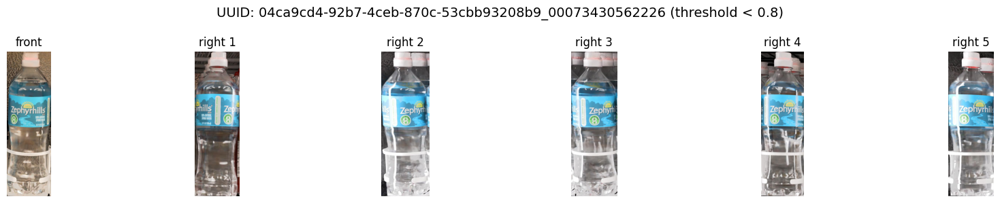

Threshold:  0.9


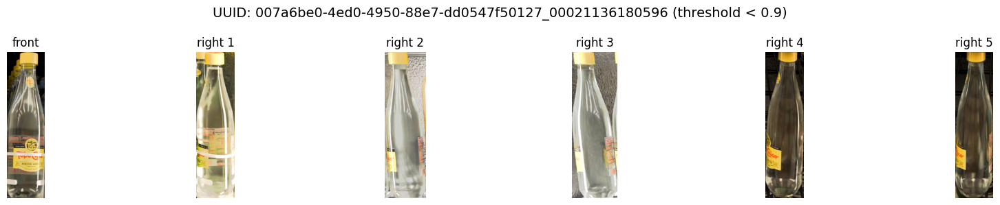

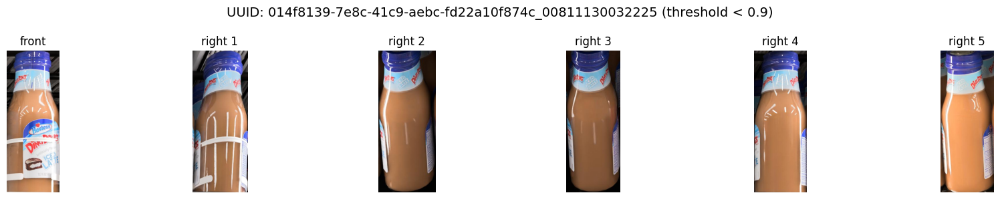

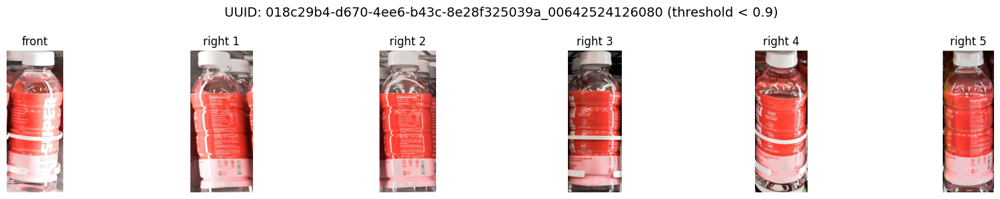

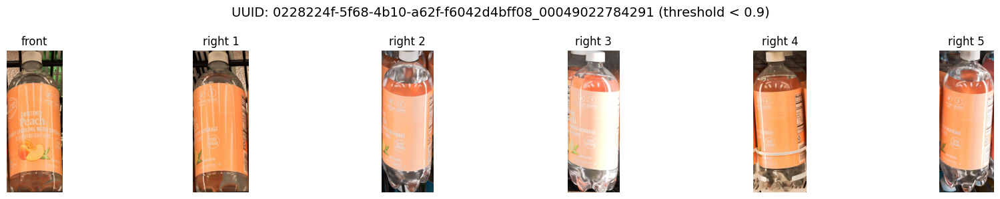

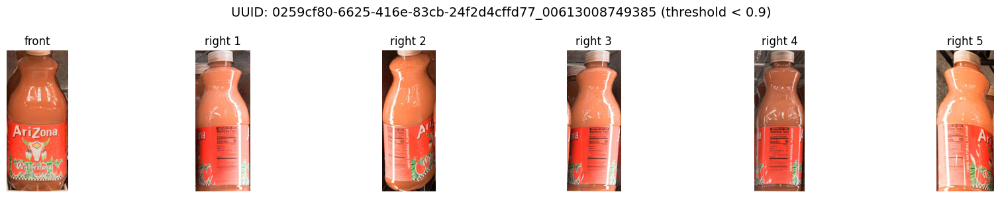

Threshold:  1.0


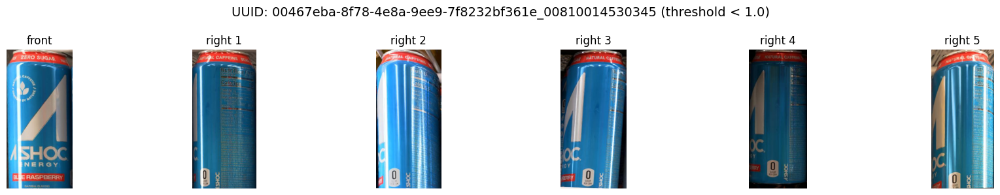

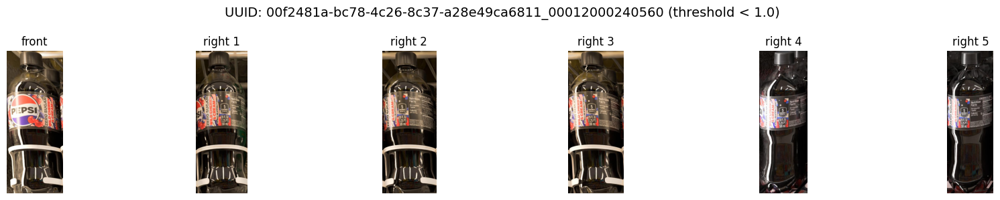

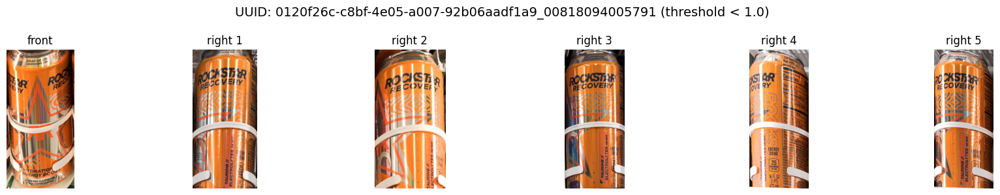

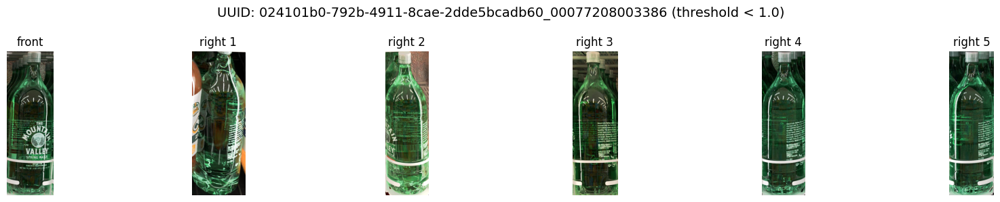

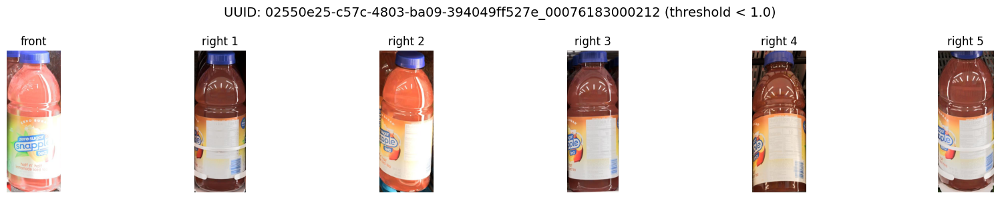

In [25]:
all_distances = []
thresholds = [0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
prev_threshold = 0.0
uuids = defaultdict(list)

for threshold in thresholds:
    print("Threshold: ", threshold)
    for uuid_i, uuid in enumerate(unique_uuids):
        uuid_mask = uuid_indices == uuid_i
        uuid_vectors = ref_vectors[uuid_mask, :]
        uuid_classes = ref_classes[uuid_mask]
        dist = face_to_face_dist(uuid_vectors, uuid_classes, face="right")
        if prev_threshold < dist.mean() < threshold:
            uuids[threshold].append(uuid)
    prev_threshold = threshold

    plot_distances(uuids[threshold], threshold, face="right", ref_face="front")

Threshold:  0.5


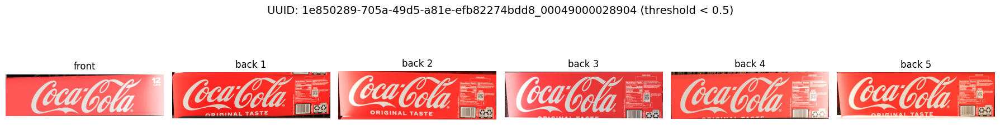

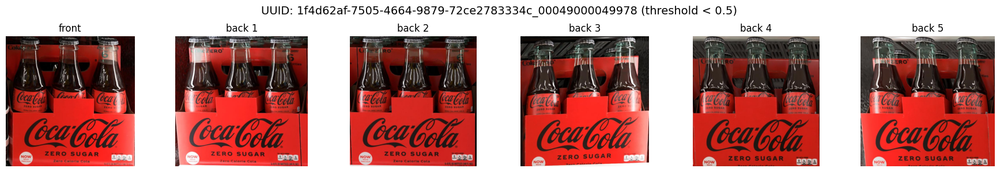

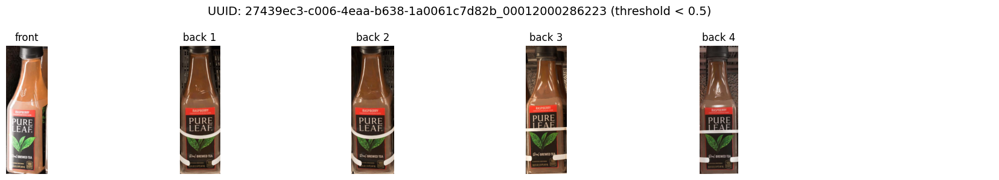

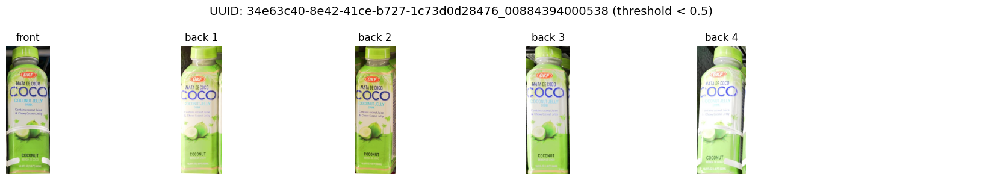

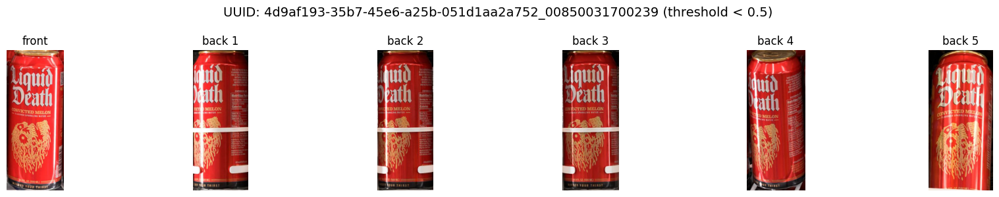

Threshold:  0.6


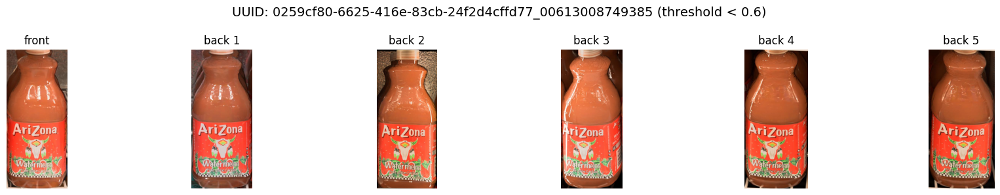

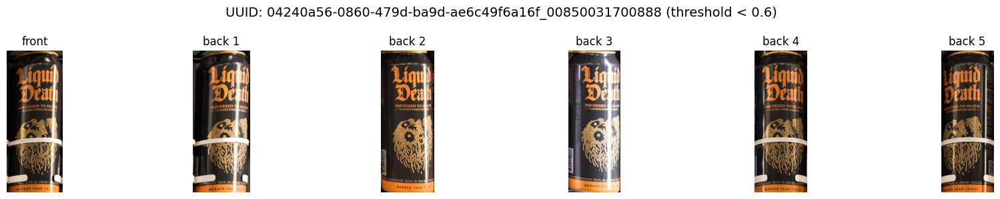

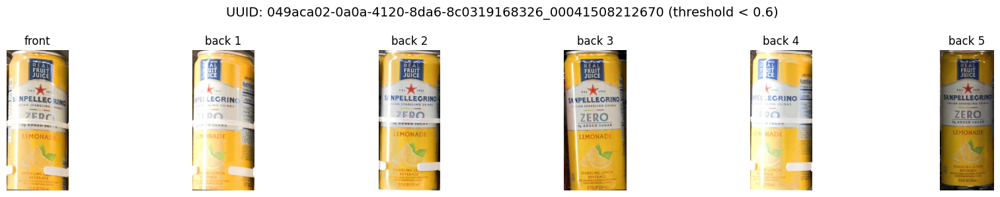

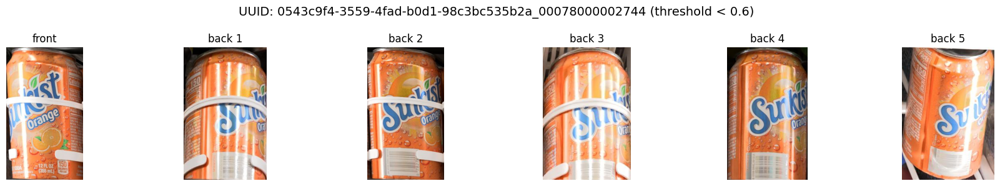

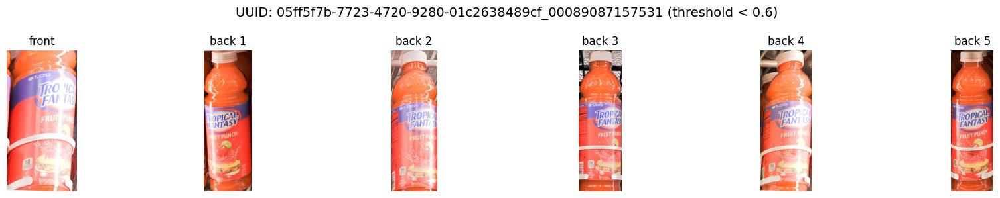

Threshold:  0.7


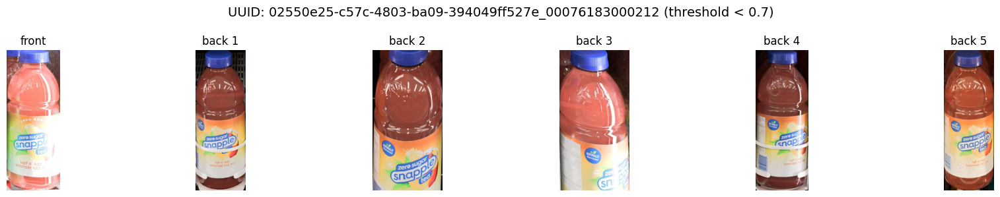

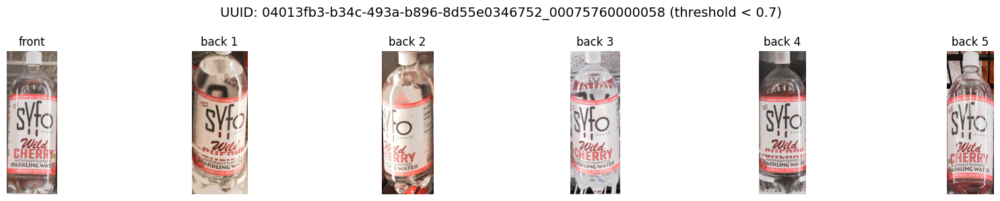

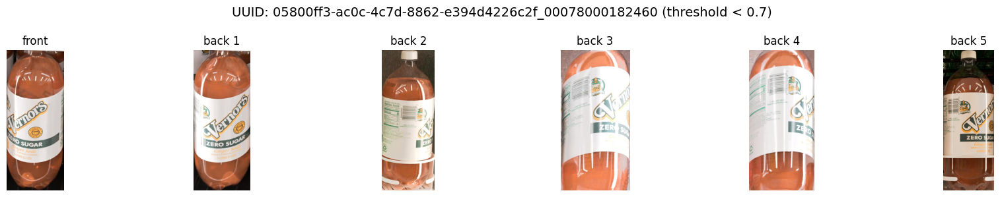

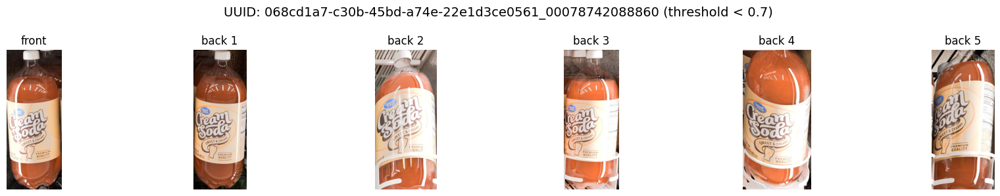

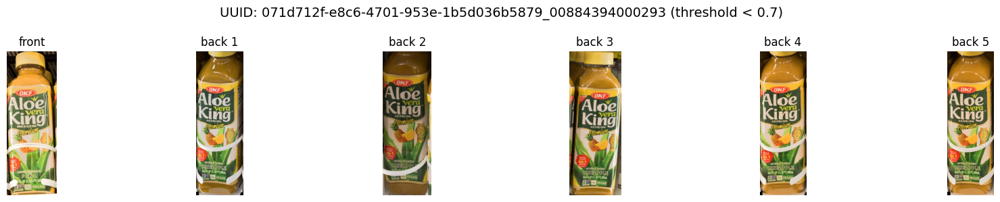

Threshold:  0.8


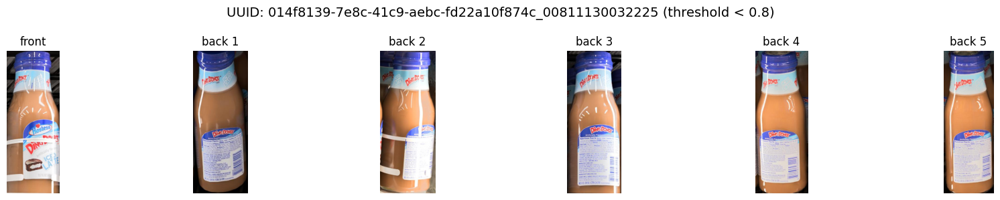

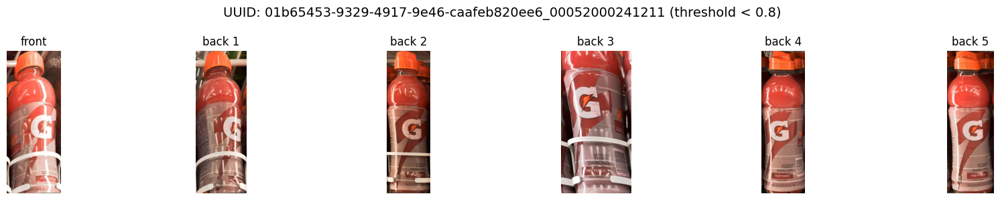

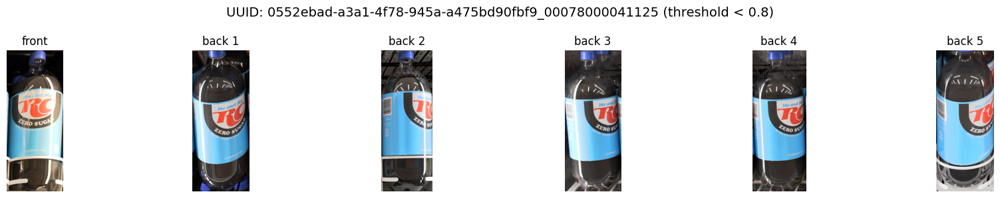

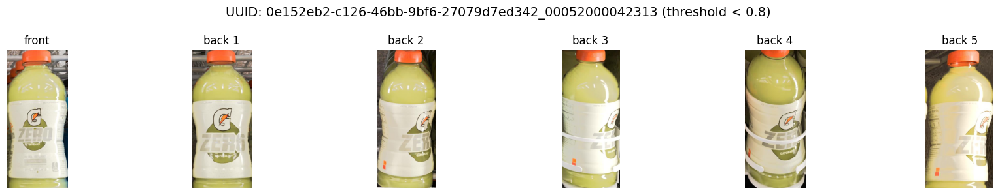

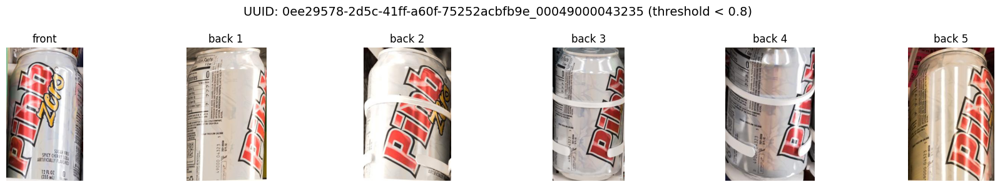

Threshold:  0.9


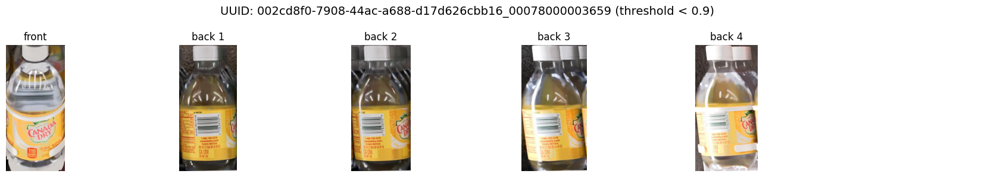

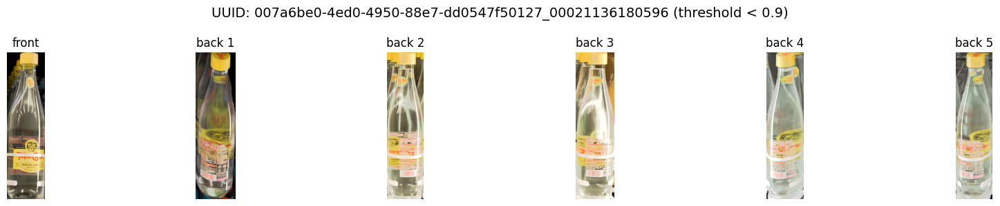

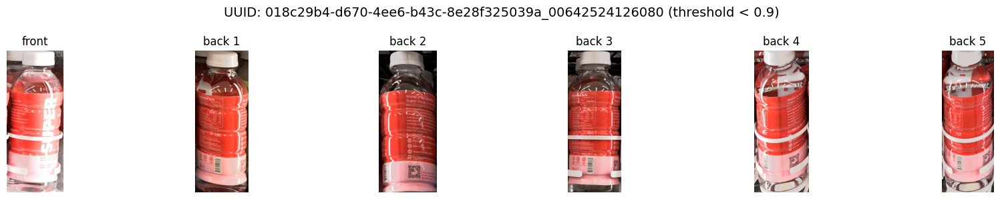

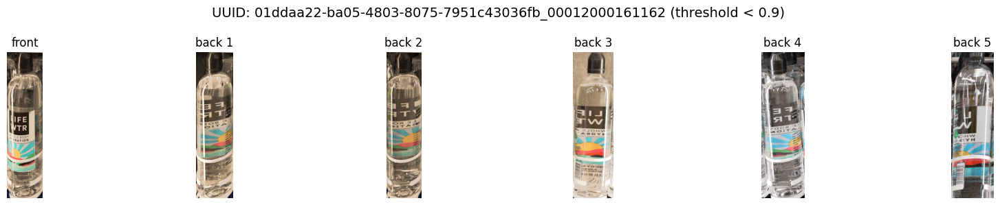

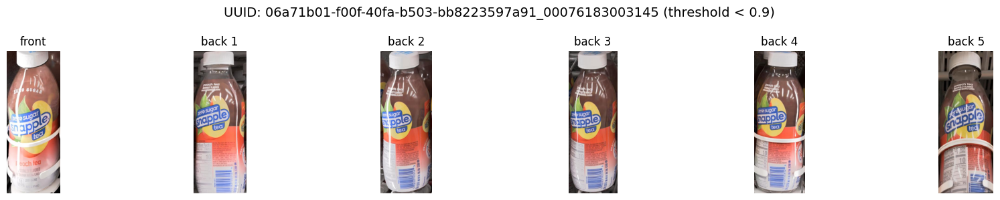

Threshold:  1.0


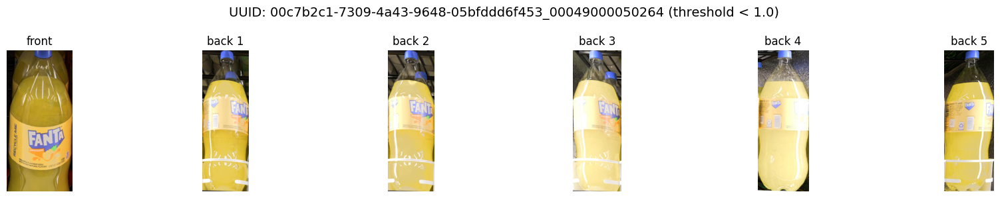

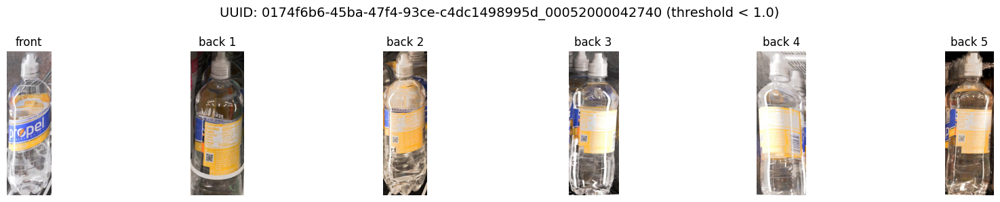

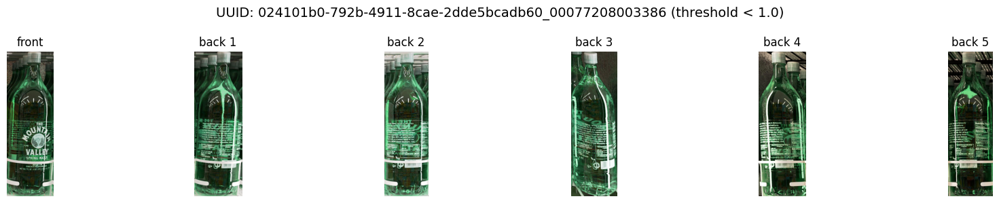

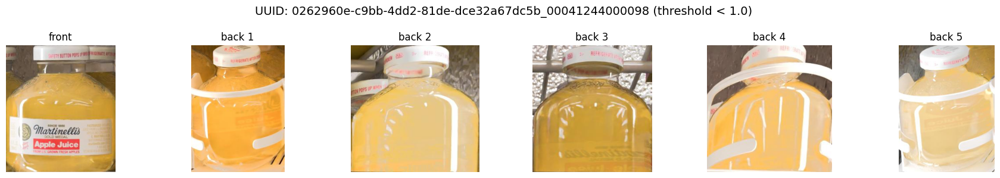

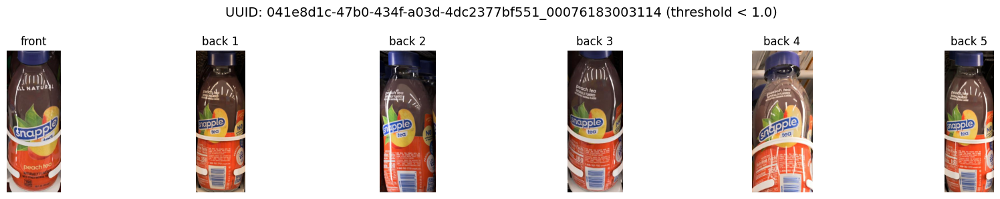

In [26]:
all_distances = []
thresholds = [0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
prev_threshold = 0.0
uuids = defaultdict(list)

for threshold in thresholds:
    print("Threshold: ", threshold)
    for uuid_i, uuid in enumerate(unique_uuids):
        uuid_mask = uuid_indices == uuid_i
        uuid_vectors = ref_vectors[uuid_mask, :]
        uuid_classes = ref_classes[uuid_mask]
        dist = face_to_face_dist(uuid_vectors, uuid_classes, face="back")
        if prev_threshold < dist.mean() < threshold:
            uuids[threshold].append(uuid)
    prev_threshold = threshold

    plot_distances(uuids[threshold], threshold, face="back", ref_face="front")

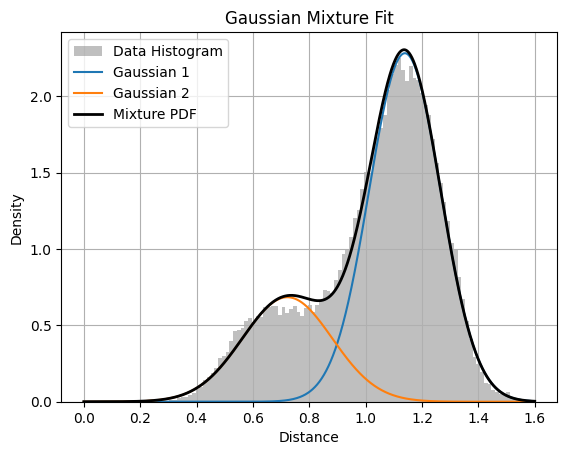

In [77]:
## gaussian mixture model
from sklearn.mixture import GaussianMixture
from scipy.stats import norm

gm = GaussianMixture(n_components=2, covariance_type="full", random_state=0).fit(
    flat_dists.reshape(-1, 1)
)
x = np.linspace(0, 1.6, 1000)
pdf1 = norm.pdf(x, gm.means_.squeeze()[0], np.sqrt(gm.covariances_.squeeze()[0]))
pdf2 = norm.pdf(x, gm.means_.squeeze()[1], np.sqrt(gm.covariances_.squeeze()[1]))
# Extract parameters
means = gm.means_.flatten()
stds = np.sqrt(gm.covariances_.flatten())
weights = gm.weights_

# Plot histogram of data
plt.hist(
    flat_dists, bins=100, density=True, alpha=0.5, color="gray", label="Data Histogram"
)
mixture_pdf = np.zeros_like(x)
# Plot each component's PDF
for i in range(2):
    pdf = weights[i] * norm.pdf(x, means[i], stds[i])
    plt.plot(x, pdf, label=f"Gaussian {i + 1}")
    mixture_pdf += pdf

# Plot the overall mixture PDF
plt.plot(x, mixture_pdf, color="black", linewidth=2, label="Mixture PDF")

plt.legend()
plt.title("Gaussian Mixture Fit")
plt.xlabel("Distance")
plt.ylabel("Density")
plt.grid(True)
plt.show()

In [ ]:
## comparing distances from front to back faces for test data

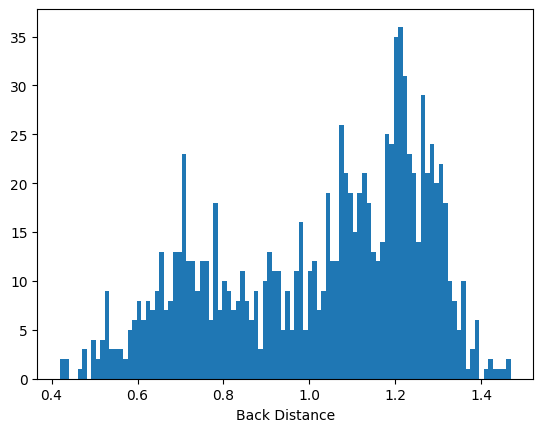

In [ ]:
all_distances = []

unique_test_classes, test_class_indices = np.unique(
    np.array(test_classes), return_inverse=True
)
unique_test_uuids, uuid_test_indices = np.unique(
    ["_".join(cls.split("_")[:-1]) for cls in test_classes], return_inverse=True
)
num_of_classes = test_class_indices[-1] + 1
num_uuids = uuid_test_indices[-1] + 1

for uuid_i, uuid in enumerate(unique_test_uuids):
    uuid_mask = uuid_test_indices == uuid_i
    uuid_vectors = test_vectors[uuid_mask, :]
    uuid_classes = test_classes[uuid_mask]
    dist = face_to_face_dist(uuid_vectors, uuid_classes, face="back")
    all_distances.append(dist)


flat_dists_test = np.concatenate([d.flatten() for d in all_distances])

plt.hist(flat_dists_test, bins=100)
plt.xlabel("Back Distance")
plt.show()

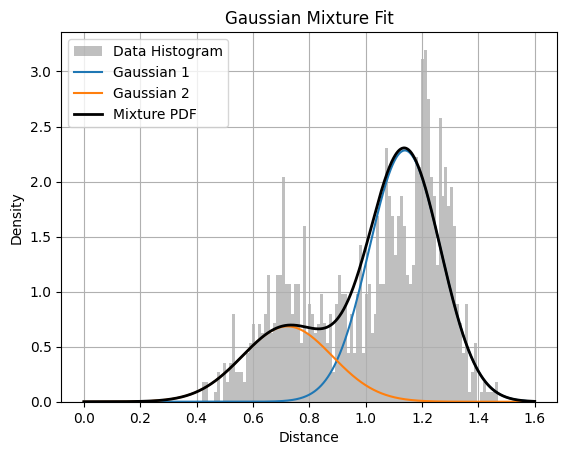

In [83]:
# Plot range
x = np.linspace(0, 1.6, 1000)

means = gm.means_.flatten()
stds = np.sqrt(gm.covariances_.flatten())
weights = gm.weights_

plt.hist(
    flat_dists_test,
    bins=100,
    density=True,
    alpha=0.5,
    color="gray",
    label="Data Histogram",
)
mixture_pdf = np.zeros_like(x)
# Plot each component's PDF
for i in range(2):
    pdf = weights[i] * norm.pdf(x, means[i], stds[i])
    plt.plot(x, pdf, label=f"Gaussian {i + 1}")
    mixture_pdf += pdf

# Plot the overall mixture PDF
plt.plot(x, mixture_pdf, color="black", linewidth=2, label="Mixture PDF")

plt.legend()
plt.title("Gaussian Mixture Fit")
plt.xlabel("Distance")
plt.ylabel("Density")
plt.grid(True)
plt.show()

In [ ]:
## want to look at distances between diff products

# KNNs

In [30]:
## train knn for specific faces

for face in ("front", "left", "right", "back", None):
    train_vectors, train_classes, sample_vectors, sample_classes = train_sample_split(
        np.array(ref_vectors), np.array(ref_classes), face=face
    )
    # fit knn to ref set
    knn = KNeighborsClassifier(n_neighbors=1, metric="euclidean")
    knn.fit(train_vectors, train_classes)

    predicted_labels = knn.predict(sample_vectors)

    correct_predictions = sum(
        [
            1
            for gt, pred in zip(sample_classes, predicted_labels)
            if gt.split("_")[1] == pred.split("_")[1]
        ]
    )
    accuracy = correct_predictions / len(sample_classes)

    print(f"Accuracy for {face}: {accuracy * 100:.2f}%")


# which ones fail?
len(sample_classes) - correct_predictions

incorrect_predictions = [
    (gt, pred)
    for gt, pred in zip(sample_classes, predicted_labels)
    if gt.split("_")[1] != pred.split("_")[1]
]

Accuracy for front: 99.79%
Accuracy for left: 96.27%
Accuracy for right: 96.81%
Accuracy for back: 96.27%
Accuracy for None: 97.43%


In [ ]:
## unweighted knn

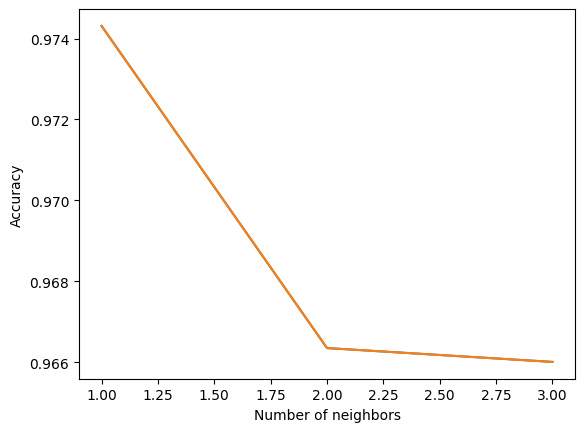

In [182]:
for metric in ["euclidean", "cosine"]:
    accuracies = []
    for k in range(1, 4):
        # print(sample_vectors.shape)
        # print(train_vectors.shape)

        # fit knn to ref set
        knn = KNeighborsClassifier(n_neighbors=k, metric=metric)
        knn.fit(train_vectors, train_classes)

        predicted_labels = knn.predict(sample_vectors)

        correct_predictions = sum(
            [
                1
                for gt, pred in zip(sample_classes, predicted_labels)
                if gt.split("_")[1] == pred.split("_")[1]
            ]
        )
        accuracy = correct_predictions / len(sample_classes)

        accuracies.append(accuracy)

    plt.plot(range(1, 4), accuracies)
    plt.xlabel("Number of neighbors")
    plt.ylabel("Accuracy")

In [ ]:
## weighted knn

In [31]:
for metric in ["euclidean", "cosine"]:
    accuracies = []
    for k in range(1, 16):
        # print(sample_vectors.shape)
        # print(train_vectors.shape)

        # fit knn to ref set
        knn = KNeighborsClassifier(n_neighbors=k, metric=metric, weights="distance")
        knn.fit(train_vectors, train_classes)

        predicted_labels = knn.predict(sample_vectors)

        correct_predictions = sum(
            [
                1
                for gt, pred in zip(sample_classes, predicted_labels)
                if gt.split("_")[1] == pred.split("_")[1]
            ]
        )
        accuracy = correct_predictions / len(sample_classes)

        accuracies.append(accuracy)

    plt.plot(range(1, 16), accuracies)
    plt.xlabel("Number of neighbors")
    plt.ylabel("Accuracy")

KeyboardInterrupt: 

In [ ]:
## creating supervectors
## find the right threshold to throw away
# whatever value i choose, we will loes ability to detect that side now, so long as it improves our ability to detect fronts thast fine


In [35]:
knn = KNeighborsClassifier(n_neighbors=1, metric="euclidean")
knn.fit(ref_vectors, ref_classes)

predicted_labels = knn.predict(test_vectors)

correct_predictions = sum(
    [
        1
        for gt, pred in zip(test_classes, predicted_labels)
        if gt.split("_")[1] == pred.split("_")[1]
    ]
)
incorrect_predictions = [
    (i, gt, pred)
    for i, (gt, pred) in enumerate(zip(test_labelled, predicted_labels))
    if gt.split("_")[1] != pred.split("_")[1]
]
accuracy = correct_predictions / len(test_classes)

accuracy

0.8947778643803586

In [ ]:
import csv

csv_file_path = os.path.join(DATA_DIR, "predictions.csv")
with open(csv_file_path, mode="w", newline="") as file:
    writer = csv.writer(file)
    writer.writerow(["gt_upc", "pred_upc"])  # Write the header
for data in incorrect_predictions[:10]:
    gt_name = data[1]
    img_number = int(gt_name.split("_")[-1])
    gt_uuid = "_".join(gt_name.split("_")[:-2])
    gt_upc = gt_name.split("_")[-3]

    folder_name = "_".join(gt_name.split("_")[:-1])
    fig, axs = plt.subplots(1, 2, figsize=(9, 3))
    fig.suptitle(f"UUID: {gt_uuid}", fontsize=3)

    img_folder = os.path.join(IMGS_DIR, "test", folder_name)
    imgs_path = sorted(
        [f for f in os.listdir(img_folder) if f.lower().endswith((".jpg", ".png"))]
    )
    img_path = imgs_path[img_number]

    pred_name = data[2]
    ref_folder = os.path.join(IMGS_DIR, DATASET)
    preds_folder = os.path.join(ref_folder, pred_name)
    preds_path = sorted(
        [f for f in os.listdir(preds_folder) if f.lower().endswith((".jpg", ".png"))]
    )
    pred_upc = pred_name.split("_")[-2]

    # with Image.open(os.path.join(img_folder,img_path)) as img:
    #     axs[0].imshow(img)

    # with Image.open(os.path.join(ref_folder,pred_name,preds_path[0])) as img:
    #     axs[1].imshow(img)
    # axs[1].axis('off')
    # plt.tight_layout()
    # plt.show();

In [ ]:
import os
from datetime import datetime

csv_file_path = os.path.join(DATA_DIR, "allfaces_incorrect.csv")
with open(csv_file_path, mode="w", newline="") as file:
    writer = csv.writer(file)
    writer.writerow(["gt_upc", "pred_upc"])  # Write the header
# Create a timestamped directory
timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
output_folder = os.path.join(IMGS_DIR, "test", "incorrect/images_allfaces")
os.makedirs(output_folder, exist_ok=True)

# Copy images into the new directory
for data in incorrect_predictions:
    gt_name = data[1]
    gt_upc = gt_name.split("_")[-3]

    img_number = int(gt_name.split("_")[-1])
    folder_name = "_".join(gt_name.split("_")[:-1])
    img_folder = os.path.join(root_folder, folder_name)
    imgs_path = sorted(
        [f for f in os.listdir(img_folder) if f.lower().endswith((".jpg", ".png"))]
    )
    img_path = imgs_path[img_number]

    src_path = os.path.join(img_folder, img_path)
    dest_path = os.path.join(output_folder, img_path)
    shutil.copy(src_path, dest_path)
    pred_name = data[2]
    pred_upc = pred_name.split("_")[-2]

print(f"Copied images to {output_folder}")

Copied images to /Users/iman/andys-ml-playground/ml-datasets/images/test/incorrect/excl_back_threshold_20250417_133508


## 0. no centroids

In [442]:
knn = KNeighborsClassifier(n_neighbors=1, metric="euclidean")
knn.fit(ref_vectors, ref_classes)

predicted_labels = knn.predict(test_vectors)
correct_predictions = sum(
    [
        1
        for gt, pred in zip(test_classes, predicted_labels)
        if gt.split("_")[1] == pred.split("_")[1]
    ]
)
accuracy = correct_predictions / len(test_classes)

print(f"{accuracy * 100:.2f}%")

89.48%


In [443]:
knn = KNeighborsClassifier(n_neighbors=1, metric="euclidean")
knn.fit(ref_vectors, ref_classes)
predicted_labels = knn.predict(test_vectors)

front_test_vectors, front_test_classes = filter_by_face(
    np.array(test_vectors), np.array(test_classes), face="front"
)

predicted_labels = knn.predict(front_test_vectors)
correct_predictions = sum(
    [
        1
        for gt, pred in zip(front_test_classes, predicted_labels)
        if gt.split("_")[1] == pred.split("_")[1]
    ]
)
accuracy = correct_predictions / len(front_test_classes)

print(f"{accuracy * 100:.2f}%")

92.44%


when evaluating on all test vectors: 
fitting knn to all reference vectors performs 2.5% better than just fitting on front ref vectors

when evaluating on front test vectors only: 
fitting knn to front vs all sides doesn't have as much difference; knn performs pretty well on front test set regardless of whether train set contains fronts only or all ref fectors: 

conclusion is that embeddings are good enough that including extra faces does not confound ability to correctly classify fronts, but not having those extra faces is harmful to testing for all faces, naturally

In [444]:
### front vectors only

In [445]:
knn = KNeighborsClassifier(n_neighbors=1, metric="euclidean")
front_ref_vectors, front_ref_classes = filter_by_face(
    np.array(ref_vectors), np.array(ref_classes), face="front"
)
knn.fit(front_ref_vectors, front_ref_classes)

predicted_labels = knn.predict(test_vectors)
correct_predictions = sum(
    [
        1
        for gt, pred in zip(test_classes, predicted_labels)
        if gt.split("_")[1] == pred.split("_")[1]
    ]
)
accuracy = correct_predictions / len(test_classes)

print(f"{accuracy * 100:.2f}%")

87.18%


In [446]:
front_ref_vectors, front_ref_classes = filter_by_face(
    np.array(ref_vectors), np.array(ref_classes), face="front"
)
knn.fit(front_ref_vectors, front_ref_classes)

front_test_vectors, front_test_classes = filter_by_face(
    np.array(test_vectors), np.array(test_classes), face="front"
)

predicted_labels = knn.predict(front_test_vectors)
correct_predictions = sum(
    [
        1
        for gt, pred in zip(front_test_classes, predicted_labels)
        if gt.split("_")[1] == pred.split("_")[1]
    ]
)
accuracy = correct_predictions / len(front_test_classes)

print(f"{accuracy * 100:.2f}%")

92.49%


## 1. all centroids

In [423]:
## same supervectors, constructing them using a for loop over uuid instead of class

In [421]:
supervectors = defaultdict(list)
for uuid_i, uuid in tqdm(enumerate(unique_uuids)):
    vectors = ref_vectors[uuid_indices == uuid_i]
    classes = ref_classes[uuid_indices == uuid_i]
    for face in ["front", "back", "left", "right"]:
        face_mask = np.array([face in cls for cls in classes])
        face_vectors = vectors[face_mask]
        supervectors[uuid + "_" + face] = np.mean(face_vectors, axis=0)

2920it [00:00, 6745.24it/s]


In [422]:
super_vectors = np.array(list(supervectors.values()))
super_classes = np.array(list(supervectors.keys()))
norm_super_vectors = (
    super_vectors / np.linalg.norm(super_vectors, axis=1)[:, np.newaxis]
)
knn = KNeighborsClassifier(n_neighbors=1, metric="euclidean")
knn.fit(norm_super_vectors, super_classes)

predicted_labels = knn.predict(test_vectors)

correct_predictions = sum(
    [
        1
        for gt, pred in zip(test_classes, predicted_labels)
        if gt.split("_")[1] == pred.split("_")[1]
    ]
)
accuracy = correct_predictions / len(test_classes)

print(f"{accuracy * 100:.2f}%")

89.32%


In [427]:
## andy's loop logic, constructing using class loop instead of uuid loop

In [428]:
unique_classes, class_indices = np.unique(np.array(ref_classes), return_inverse=True)
unique_uuids, uuid_indices = np.unique(
    ["_".join(cls.split("_")[:-1]) for cls in ref_classes], return_inverse=True
)
num_of_classes = class_indices[-1] + 1
num_uuids = uuid_indices[-1] + 1
supervectors = np.empty((num_of_classes, 256), dtype=ref_vectors.dtype)

for class_i in tqdm(range(num_of_classes)):
    vectors = ref_vectors[class_indices == class_i]
    supervectors[class_i, :] = np.mean(vectors, axis=0)

superclasses = unique_classes

100%|██████████| 11680/11680 [00:00<00:00, 15871.07it/s]


In [430]:
knn = KNeighborsClassifier(n_neighbors=1, metric="euclidean")
normalised_supervectors = (
    supervectors / np.linalg.norm(supervectors, axis=1)[:, np.newaxis]
)
knn.fit(normalised_supervectors, superclasses)

predicted_labels = knn.predict(test_vectors)

correct_predictions = sum(
    [
        1
        for gt, pred in zip(test_classes, predicted_labels)
        if gt.split("_")[1] == pred.split("_")[1]
    ]
)
accuracy = correct_predictions / len(test_classes)

print(f"{accuracy * 100:.2f}%")

89.32%


using centroids is as effective as using no centroids/all reference vectors in the first cell in 0. 

89.32% vs 89.48% and it removes the ambiguity of needing to tune k neighbours, more robust, less data

### sense check with NearestCentroid
we need to keep supervectors unnormalised here as NearestCentroid doesn't normalise the centroids

In [437]:
from sklearn.neighbors import NearestCentroid

## knn with unnormalised supervectors
knn = KNeighborsClassifier(n_neighbors=1, metric="euclidean")
knn.fit(supervectors, superclasses)

predicted_labels = knn.predict(test_vectors)

correct_predictions = sum(
    [
        1
        for gt, pred in zip(test_classes, predicted_labels)
        if gt.split("_")[1] == pred.split("_")[1]
    ]
)
accuracy = correct_predictions / len(test_classes)

print(f"Accuracy for unnormalised supervectors: {accuracy * 100:.2f}%")

## nearest centroid
knn = NearestCentroid(metric="euclidean")
knn.fit(ref_vectors, ref_classes)

predicted_labels = knn.predict(test_vectors)
predicted_upc = np.array([pred.split("_")[1] for pred in predicted_labels])

gt = np.array([gt.split("_")[1] for gt in test_classes])
centroid_correct = predicted_upc == gt
accuracy = np.count_nonzero(centroid_correct) / centroid_correct.shape[0]
print(f"Accuracy for NearestCentroid: {accuracy * 100:.2f}%")

Accuracy for unnormalised supervectors: 88.85%
Accuracy for NearestCentroid: 88.85%


### sense check with NearestCentroid using fronts only

In [438]:
## knn with unnormalised supervectors
knn = KNeighborsClassifier(n_neighbors=1, metric="euclidean")
front_supervectors, front_superclasses = filter_by_face(
    np.array(supervectors), np.array(superclasses), face="front"
)
knn.fit(front_supervectors, front_superclasses)

predicted_labels = knn.predict(front_test_vectors)
correct_predictions = sum(
    [
        1
        for gt, pred in zip(front_test_classes, predicted_labels)
        if gt.split("_")[1] == pred.split("_")[1]
    ]
)
accuracy = correct_predictions / len(front_test_classes)

print(f"Accuracy for unnormalised front supervectors: {accuracy * 100:.2f}%")

## nearest centroid
knn = NearestCentroid(metric="euclidean")
front_ref_vectors, front_ref_classes = filter_by_face(
    np.array(ref_vectors), np.array(ref_classes), face="front"
)
knn.fit(front_ref_vectors, front_ref_classes)

front_test_vectors, front_test_classes = filter_by_face(
    np.array(test_vectors), np.array(test_classes), face="front"
)
predicted_labels = knn.predict(front_test_vectors)
predicted_upc = np.array([pred.split("_")[1] for pred in predicted_labels])

gt = np.array([gt.split("_")[1] for gt in front_test_classes])
centroid_correct = predicted_upc == gt
accuracy = np.count_nonzero(centroid_correct) / centroid_correct.shape[0]
print(f"Accuracy for NearestCentroid with fronts only: {accuracy * 100:.2f}%")

Accuracy for unnormalised front supervectors: 92.44%
Accuracy for NearestCentroid with fronts only: 92.44%


In [1]:
## need to normalize the supervectors
unique_classes, class_indices = np.unique(np.array(ref_classes), return_inverse=True)
unique_uuids, uuid_indices = np.unique(
    ["_".join(cls.split("_")[:-1]) for cls in ref_classes], return_inverse=True
)
num_of_classes = class_indices[-1] + 1
num_uuids = uuid_indices[-1] + 1
supervectors = np.empty((num_of_classes, 256), dtype=ref_vectors.dtype)

for class_i in tqdm(range(num_of_classes)):
    vectors = ref_vectors[class_indices == class_i]
    supervectors[class_i, :] = np.mean(vectors, axis=0)

supervectors /= np.linalg.norm(supervectors, axis=1)[:, np.newaxis]
superclasses = unique_classes

NameError: name 'np' is not defined

## 2. combine centroids

In [ ]:
supervectors = defaultdict(list)

unique_classes, class_indices = np.unique(np.array(ref_classes), return_inverse=True)
unique_uuids, uuid_indices = np.unique(
    ["_".join(cls.split("_")[:-1]) for cls in ref_classes], return_inverse=True
)
num_of_classes = class_indices[-1] + 1
num_uuids = uuid_indices[-1] + 1

for uuid_i, uuid in tqdm(enumerate(unique_uuids)):
    uuid_ref_vectors = ref_vectors[uuid_indices == uuid_i]
    uuid_ref_classes = np.array(ref_classes)[uuid_indices == uuid_i]
    front_vectors, front_classes = filter_by_face(
        uuid_ref_vectors, uuid_ref_classes, face="front"
    )

    for face in ["back", "left", "right"]:
        face_vectors, face_classes = filter_by_face(
            uuid_ref_vectors, uuid_ref_classes, face=face
        )
        if face == "back":
            dist = scipy.spatial.distance.cdist(front_vectors, face_vectors)
            if dist.mean() < 0.7:
                # Combine front + back vectors into one supervector
                front_vectors = np.concatenate([front_vectors, face_vectors], axis=0)
                continue  # skip adding a separate back vector
        supervectors[uuid + "_" + face] = np.mean(face_vectors, axis=0)
    # Only add front supervector if not already added above
    if uuid + "_front" not in supervectors:
        supervectors[uuid + "_front"] = np.mean(front_vectors, axis=0)

2920it [00:03, 846.76it/s]


In [299]:
len(supervectors)

11337

In [189]:
## test on ref set

In [300]:
super_vectors = [sv for sv in supervectors.values()]
super_classes = [sc for sc in supervectors.keys()]

knn = KNeighborsClassifier(n_neighbors=1, metric="euclidean")
knn.fit(np.array(super_vectors), np.array(super_classes))

predicted_labels = knn.predict(sample_vectors)

correct_predictions = sum(
    [
        1
        for gt, pred in zip(sample_classes, predicted_labels)
        if gt.split("_")[1] == pred.split("_")[1]
    ]
)
accuracy = correct_predictions / len(sample_classes)

print(f"{accuracy * 100:.2f}%")

99.31%


In [ ]:
## test on test set

In [301]:
predicted_labels = knn.predict(test_vectors)

correct_predictions = sum(
    [
        1
        for gt, pred in zip(test_classes, predicted_labels)
        if gt.split("_")[1] == pred.split("_")[1]
    ]
)
accuracy = correct_predictions / len(test_classes)

print(f"{accuracy * 100:.2f}%")

88.89%


slight drop in performance when combining back vectors into front supervectors for products with small front-to-back distances (0.4%)

### analysis bits

In [ ]:
## testing with real images

In [448]:
k = 5
knn = KNeighborsClassifier(n_neighbors=k, metric="euclidean")

knn.fit(front_ref_vectors, front_ref_classes)

front_test_vectors, front_test_classes = filter_by_face(
    np.array(test_vectors), np.array(test_classes), face="front"
)

distances, indices = knn.kneighbors(front_test_vectors)
predicted_labels = knn.predict(front_test_vectors)
predicted_upc = np.array([pred.split("_")[1] for pred in predicted_labels])

front_ref_classes = np.array(front_ref_classes)
all_predicted_labels = front_ref_classes[indices]

gt = np.array([gt.split("_")[1] for gt in front_test_classes])
correct = predicted_upc == gt
accuracy = np.count_nonzero(correct) / correct.shape[0]
print(f"Accuracy: {accuracy * 100:.2f}%")


k_five_incorrect = np.nonzero(~correct)[0]
k_five_incorrect.shape

Accuracy: 92.04%


(160,)

In [449]:
front_ref_vectors, front_ref_classes = filter_by_face(
    ref_vectors, np.array(ref_classes), face="front"
)

k = 1
knn = KNeighborsClassifier(n_neighbors=k, metric="euclidean")

knn.fit(front_ref_vectors, front_ref_classes)

front_test_vectors, front_test_classes = filter_by_face(
    np.array(test_vectors), np.array(test_classes), face="front"
)

distances, indices = knn.kneighbors(front_test_vectors)
predicted_labels = knn.predict(front_test_vectors)
predicted_upc = np.array([pred.split("_")[1] for pred in predicted_labels])

front_ref_classes = np.array(front_ref_classes)
all_predicted_labels = front_ref_classes[indices]

gt = np.array([gt.split("_")[1] for gt in front_test_classes])
correct = predicted_upc == gt
accuracy = np.count_nonzero(correct) / correct.shape[0]
print(f"Accuracy: {accuracy * 100:.2f}%")


k_one_incorrect = np.nonzero(~correct)[0]
k_one_incorrect.shape

k1ik5c = np.setdiff1d(k_one_incorrect, k_five_incorrect)
k5ik1c = np.setdiff1d(k_five_incorrect, k_one_incorrect)

print(
    f"k=1 {1 - 151 / 2011}, k=5 {1 - k_five_incorrect.shape[0] / 2011}, -{k5ik1c.shape[0] / 2011} +{k1ik5c.shape[0] / 2011}"
)
print(
    f"k=1 {2011 - 151}, k=5 {2011 - k_five_incorrect.shape[0]}, -{k5ik1c.shape[0]} +{k1ik5c.shape[0]}"
)

distances[k5ik1c][1, :]
gt[k5ik1c][:5]

k5ik1clabels = all_predicted_labels[k5ik1c]
k5ik1clabels

print(np.count_nonzero(correct) / correct.shape[0])

np.count_nonzero(correct) - np.count_nonzero(centroid_correct)

# 1860 - 18 + 17

np.count_nonzero(np.logical_and(correct, ~centroid_correct))

Accuracy: 92.49%
k=1 0.9249129786176031, k=5 0.9204375932371954, -0.009945300845350571 +0.005469915464942815
k=1 1860, k=5 1851, -20 +11
0.9249129786176031


18

## 3. drop back centroid

In [343]:
unique_classes, class_indices = np.unique(np.array(ref_classes), return_inverse=True)
unique_uuids, uuid_indices = np.unique(
    ["_".join(cls.split("_")[:-1]) for cls in ref_classes], return_inverse=True
)
num_of_classes = class_indices[-1] + 1
num_uuids = uuid_indices[-1] + 1
supervectors = np.empty((num_of_classes, 256), dtype=ref_vectors.dtype)

for class_i in tqdm(range(num_of_classes)):
    vectors = ref_vectors[class_indices == class_i]
    supervectors[class_i, :] = np.mean(vectors, axis=0)

supervectors /= np.linalg.norm(supervectors, axis=1)[:, np.newaxis]
superclasses = unique_classes

100%|██████████| 11680/11680 [00:00<00:00, 15994.13it/s]


In [316]:
import scipy.spatial.distance

for threshold in (0, 0.2, 0.5, 0.8, 1.5):
    supervector_classes = unique_classes

    front_mask = np.array(["front" in label for label in supervector_classes])
    back_mask = np.array(["back" in label for label in supervector_classes])
    front_svs = supervectors[front_mask, :]
    back_svs = supervectors[back_mask, :]

    distances = scipy.spatial.distance.cdist(back_svs, front_svs)

    # TODO: plot prods
    close_products_mask = np.min(distances, axis=0) < threshold
    thres_mask = np.min(distances, axis=1) > threshold

    filtered_supervectors = np.concatenate((front_svs, back_svs[thres_mask]), axis=0)
    filtered_supervectors.shape

    filtered_sv_classes = np.concatenate(
        (supervector_classes[front_mask], supervector_classes[back_mask][thres_mask])
    )
    filtered_sv_classes.shape

    k = 1
    knn = KNeighborsClassifier(n_neighbors=k, metric="euclidean")

    knn.fit(filtered_supervectors, filtered_sv_classes)

    front_test_vectors, front_test_classes = filter_by_face(
        np.array(test_vectors), np.array(test_classes), face="front"
    )

    distances, indices = knn.kneighbors(front_test_vectors)
    predicted_labels = knn.predict(front_test_vectors)
    predicted_upc = np.array([pred.split("_")[1] for pred in predicted_labels])

    gt = np.array([gt.split("_")[1] for gt in front_test_classes])
    correct = predicted_upc == gt

    print(
        f"threshold {threshold}:",
        np.count_nonzero(correct) / correct.shape[0],
        f"classes: {filtered_classes.shape[0]}",
    )

threshold 0: 0.9214321233217305 classes: 11680
threshold 0.2: 0.9214321233217305 classes: 11680
threshold 0.5: 0.921929388363998 classes: 11680
threshold 0.8: 0.9234211834908006 classes: 11680
threshold 1.5: 0.9254102436598707 classes: 11680


threshold 1.5: 0.9249129786176031 classes: 8760, incorrect: 151
threshold 1.0: 0.9244157135753357 classes: 10179, incorrect: 152
threshold 0.9: 0.9244157135753357 classes: 10623, incorrect: 152
threshold 0.8: 0.9239184485330681 classes: 10878, incorrect: 153
threshold 0.7: 0.9239184485330681 classes: 11020, incorrect: 153
threshold 0.6: 0.9239184485330681 classes: 11151, incorrect: 153
threshold 0.5: 0.922923918448533 classes: 11262, incorrect: 155
threshold 0.4: 0.922923918448533 classes: 11385, incorrect: 155
threshold 0.3: 0.9224266534062655 classes: 11530, incorrect: 156
threshold 0.2: 0.9224266534062655 classes: 11657, incorrect: 156
threshold 0: 0.9224266534062655 classes: 11680, incorrect: 156


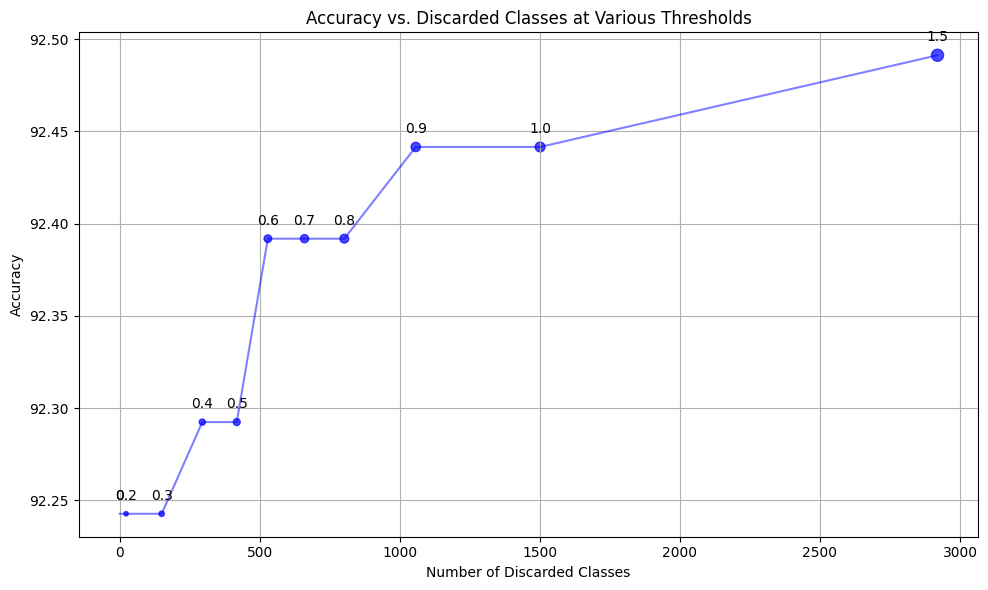

In [ ]:
copied_images_prev = set()  # Track copied image paths
copied_images_dict = {}

ref_folder = os.path.join(IMGS_DIR, DATASET)
test_folder = os.path.join(IMGS_DIR, "test")

disc_classes = []
accuracies = []
thresholds = [1.5, 1.0, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0]

for threshold in thresholds:
    supervector_classes = unique_classes

    front_mask = np.array(["front" in label for label in supervector_classes])
    back_mask = np.array(["back" in label for label in supervector_classes])
    sides_mask = np.array(
        ["left" in label or "right" in label for label in supervector_classes]
    )
    non_back_mask = ~back_mask
    non_back_svs = supervectors[non_back_mask, :]
    front_svs = supervectors[front_mask, :]
    back_svs = supervectors[back_mask, :]

    distances = scipy.spatial.distance.cdist(back_svs, front_svs)

    close_products_mask = np.min(distances, axis=1) < threshold
    close_classes = supervector_classes[back_mask][close_products_mask]

    thres_mask = np.min(distances, axis=1) > threshold

    filtered_supervectors = np.concatenate((non_back_svs, back_svs[thres_mask]), axis=0)
    filtered_sv_classes = np.concatenate(
        (supervector_classes[~back_mask], supervector_classes[back_mask][thres_mask])
    )

    knn = KNeighborsClassifier(n_neighbors=1, metric="euclidean")
    knn.fit(filtered_supervectors, filtered_sv_classes)

    front_test_vectors, front_test_classes = filter_by_face(
        np.array(test_vectors), np.array(test_classes), face="front"
    )
    front_test_mask = np.array(["front" in label for label in test_classes])
    front_test_labelled = np.array(test_labelled)[front_test_mask]

    distances, indices = knn.kneighbors(front_test_vectors)
    predicted_labels = knn.predict(front_test_vectors)
    predicted_upc = np.array([pred.split("_")[1] for pred in predicted_labels])
    gt = np.array([gt.split("_")[1] for gt in front_test_classes])
    correct = predicted_upc == gt
    copied_images_dict[threshold] = []

    incorrect_predictions = [
        (i, gt_name, pred)
        for i, (gt_name, pred) in enumerate(zip(front_test_labelled, predicted_labels))
        if gt_name.split("_")[1] != pred.split("_")[1]
    ]

    output_folder = os.path.join(root_folder, f"rejected_classes/threshold_{threshold}")
    os.makedirs(output_folder, exist_ok=True)
    for cls in close_classes:
        uuid = "_".join(cls.split("_")[:-1])
        img_folder = os.path.join(ref_folder, cls)
        imgs_path = sorted(
            [f for f in os.listdir(img_folder) if f.lower().endswith((".jpg", ".png"))]
        )
        img_path = imgs_path[0]
        src_path = os.path.join(img_folder, img_path)
        dest_path = os.path.join(output_folder, img_path)
        shutil.copy(src_path, dest_path)

    output_folder = os.path.join(
        test_folder, f"incorrect/exclbacks_threshold_{threshold}"
    )
    os.makedirs(output_folder, exist_ok=True)

    for data in incorrect_predictions:
        gt_name = data[1]
        img_number = int(gt_name.split("_")[-1])
        folder_name = "_".join(gt_name.split("_")[:-1])
        img_folder = os.path.join(test_folder, folder_name)
        imgs_path = sorted(
            [f for f in os.listdir(img_folder) if f.lower().endswith((".jpg", ".png"))]
        )
        img_path = imgs_path[img_number]
        src_path = os.path.join(img_folder, img_path)

        if src_path not in copied_images_prev:
            dest_path = os.path.join(output_folder, img_path)
            shutil.copy(src_path, dest_path)
            copied_images_prev.add(src_path)
            copied_images_dict[threshold].append(gt_name.split("_")[-3])

    print(
        f"threshold {threshold}:",
        np.count_nonzero(correct) / correct.shape[0],
        f"classes: {filtered_sv_classes.shape[0]}, incorrect: {len(incorrect_predictions)}",
    )
    disc_classes.append(len(supervector_classes) - filtered_sv_classes.shape[0])
    accuracies.append(np.count_nonzero(correct) / correct.shape[0])

with open(os.path.join(test_folder, "incorrect/upcs.json"), "w") as f:
    json.dump(copied_images_dict, f)

# Normalize or scale marker sizes based on threshold
marker_sizes = [t * 50 for t in thresholds]  # Adjust the multiplier to taste
plt_accuracies = [a * 100 for a in accuracies]  # Convert accuracies to percentage
plt.figure(figsize=(10, 6))
plt.scatter(disc_classes, plt_accuracies, s=marker_sizes, c="blue", alpha=0.7)
plt.plot(
    disc_classes, plt_accuracies, color="blue", alpha=0.5
)  # Connect points with a line
plt.xlabel("Number of Discarded Classes")
plt.ylabel("Accuracy")
plt.title("Accuracy vs. Discarded Classes at Various Thresholds")

# Annotate each point with its threshold
for i, threshold in enumerate(thresholds):
    plt.annotate(
        f"{threshold}",
        (disc_classes[i], plt_accuracies[i]),
        textcoords="offset points",
        xytext=(0, 10),
        ha="center",
    )

plt.grid(True)
plt.tight_layout()
plt.show()

### 1.5 is basically removing all backs, leading to highest accuracy on test set

threshold 1.5: 0.9249129786176031 classes: 8760, incorrect: 151
threshold 1.0: 0.9244157135753357 classes: 10179, incorrect: 152
threshold 0.9: 0.9244157135753357 classes: 10623, incorrect: 152
threshold 0.8: 0.9239184485330681 classes: 10878, incorrect: 153
threshold 0.7: 0.9239184485330681 classes: 11020, incorrect: 153
threshold 0.6: 0.9239184485330681 classes: 11151, incorrect: 153
threshold 0.5: 0.922923918448533 classes: 11262, incorrect: 155
threshold 0.4: 0.922923918448533 classes: 11385, incorrect: 155
threshold 0.3: 0.9224266534062655 classes: 11530, incorrect: 156
threshold 0.2: 0.9224266534062655 classes: 11657, incorrect: 156
threshold 0: 0.9224266534062655 classes: 11680, incorrect: 156


'front' included in ground truth (match UPC + face)
threshold 0: 0.8458478368970661 classes: 11680
threshold 0.2: 0.8458478368970661 classes: 11655
threshold 0.5: 0.8746892093485827 classes: 10917
threshold 0.8: 0.9030333167578319 classes: 8494
threshold 1.5: 0.9254102436598707 classes: 2920

'front' not included in ground truth (match UPC only)
threshold 0: 0.9224266534062655 classes: 11680
threshold 0.2: 0.9224266534062655 classes: 11655
threshold 0.5: 0.922923918448533 classes: 10917
threshold 0.8: 0.9249129786176031 classes: 8494
threshold 1.5: 0.9254102436598707 classes: 2920

threshold 1.5: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 1.0: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.9: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.8: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.7: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.6: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.5: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.4: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.3: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.2: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0: 0.9224266534062655 classes: 11680, incorrect: 156


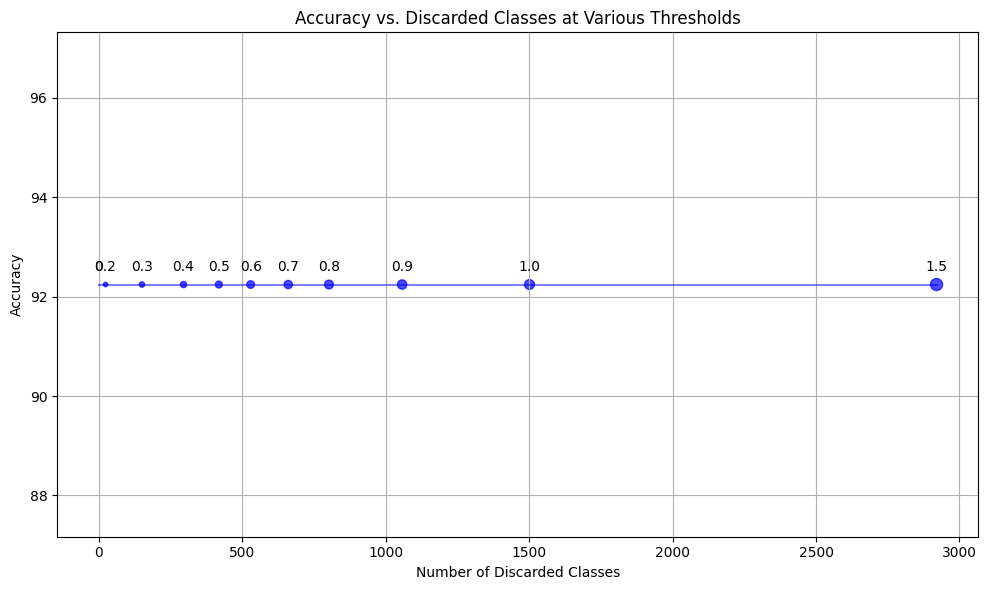

In [ ]:
copied_images_prev = set()  # Track copied image paths
copied_images_dict = {}

disc_classes = []
accuracies = []
thresholds = [1.5, 1.0, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0]

for threshold in thresholds:
    supervector_classes = unique_classes

    front_mask = np.array(["front" in label for label in supervector_classes])
    back_mask = np.array(["back" in label for label in supervector_classes])
    non_back_mask = ~back_mask
    non_back_svs = supervectors[non_back_mask, :]
    front_svs = supervectors[front_mask, :]
    back_svs = supervectors[back_mask, :]

    distances = scipy.spatial.distance.cdist(back_svs, front_svs)

    close_products_mask = np.min(distances, axis=1) < threshold
    close_classes = supervector_classes[back_mask][close_products_mask]

    thres_mask = np.min(distances, axis=1) > threshold

    # filtered_supervectors = np.concatenate((non_back_svs, back_svs[thres_mask]), axis=0)
    # filtered_sv_classes = np.concatenate((supervector_classes[~back_mask], supervector_classes[back_mask][thres_mask]))
    new_back_classes = supervector_classes[back_mask]
    new_back_classes[close_products_mask] = np.array(
        [cls.replace("back", "front") for cls in new_back_classes[close_products_mask]]
    )

    filtered_sv_classes = np.concatenate(
        (supervector_classes[~back_mask], new_back_classes)
    )
    filtered_supervectors = np.concatenate(
        (supervectors[~back_mask], supervectors[back_mask]), axis=0
    )
    knn = KNeighborsClassifier(n_neighbors=1, metric="euclidean")
    knn.fit(filtered_supervectors, filtered_sv_classes)

    front_test_vectors, front_test_classes = filter_by_face(
        np.array(test_vectors), np.array(test_classes), face="front"
    )
    front_test_mask = np.array(["front" in label for label in test_classes])
    front_test_labelled = np.array(test_labelled)[front_test_mask]

    distances, indices = knn.kneighbors(front_test_vectors)
    predicted_labels = knn.predict(front_test_vectors)
    predicted_upc = np.array([pred.split("_")[1] for pred in predicted_labels])
    gt = np.array([gt.split("_")[1] for gt in front_test_classes])
    correct = predicted_upc == gt
    copied_images_dict[threshold] = []

    incorrect_predictions = [
        (i, gt_name, pred)
        for i, (gt_name, pred) in enumerate(zip(front_test_labelled, predicted_labels))
        if gt_name.split("_")[1] != pred.split("_")[1]
    ]

    print(
        f"threshold {threshold}:",
        np.count_nonzero(correct) / correct.shape[0],
        f"classes: {filtered_sv_classes.shape[0]}, incorrect: {len(incorrect_predictions)}",
    )
    disc_classes.append(np.count_nonzero(close_products_mask))
    accuracies.append(np.count_nonzero(correct) / correct.shape[0])


# Normalize or scale marker sizes based on threshold
marker_sizes = [t * 50 for t in thresholds]  # Adjust the multiplier to taste
plt_accuracies = [acc * 100 for acc in accuracies]  # Convert to percentage
plt.figure(figsize=(10, 6))
plt.scatter(disc_classes, plt_accuracies, s=marker_sizes, c="blue", alpha=0.7)
plt.plot(
    disc_classes, plt_accuracies, color="blue", alpha=0.5
)  # Connect points with a line
plt.xlabel("Number of Discarded Classes")
plt.ylabel("Accuracy")
plt.title("Accuracy vs. Discarded Classes at Various Thresholds")

# Annotate each point with its threshold
for i, threshold in enumerate(thresholds):
    plt.annotate(
        f"{threshold}",
        (disc_classes[i], plt_accuracies[i]),
        textcoords="offset points",
        xytext=(0, 10),
        ha="center",
    )

plt.grid(True)
plt.tight_layout()
plt.show()

threshold 1.5: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 1.0: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.9: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.8: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.7: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.6: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.5: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.4: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.3: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0.2: 0.9224266534062655 classes: 11680, incorrect: 156
threshold 0: 0.9224266534062655 classes: 11680, incorrect: 156


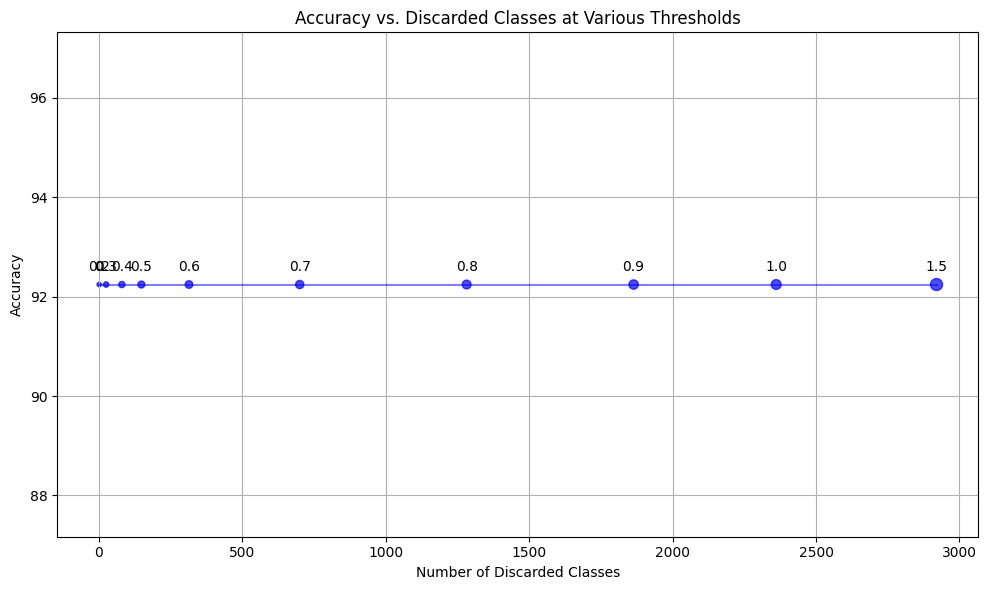

In [ ]:
copied_images_prev = set()  # Track copied image paths
copied_images_dict = {}

disc_classes = []
accuracies = []
thresholds = [1.5, 1.0, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0]

for threshold in thresholds:
    supervector_classes = unique_classes

    front_mask = np.array(["front" in label for label in supervector_classes])
    back_mask = np.array(["left" in label for label in supervector_classes])
    non_back_mask = ~back_mask
    non_back_svs = supervectors[non_back_mask, :]
    front_svs = supervectors[front_mask, :]
    back_svs = supervectors[back_mask, :]

    distances = scipy.spatial.distance.cdist(back_svs, front_svs)

    close_products_mask = np.min(distances, axis=1) < threshold
    close_classes = supervector_classes[back_mask][close_products_mask]

    thres_mask = np.min(distances, axis=1) > threshold

    # filtered_supervectors = np.concatenate((non_back_svs, back_svs[thres_mask]), axis=0)
    # filtered_sv_classes = np.concatenate((supervector_classes[~back_mask], supervector_classes[back_mask][thres_mask]))
    new_back_classes = supervector_classes[back_mask]
    new_back_classes[close_products_mask] = np.array(
        [cls.replace("left", "front") for cls in new_back_classes[close_products_mask]]
    )

    filtered_sv_classes = np.concatenate(
        (supervector_classes[~back_mask], new_back_classes)
    )
    filtered_supervectors = np.concatenate(
        (supervectors[~back_mask], supervectors[back_mask]), axis=0
    )
    knn = KNeighborsClassifier(n_neighbors=1, metric="euclidean")
    knn.fit(filtered_supervectors, filtered_sv_classes)

    front_test_vectors, front_test_classes = filter_by_face(
        np.array(test_vectors), np.array(test_classes), face="front"
    )
    front_test_mask = np.array(["front" in label for label in test_classes])
    front_test_labelled = np.array(test_labelled)[front_test_mask]

    distances, indices = knn.kneighbors(front_test_vectors)
    predicted_labels = knn.predict(front_test_vectors)
    predicted_upc = np.array([pred.split("_")[1] for pred in predicted_labels])
    gt = np.array([gt.split("_")[1] for gt in front_test_classes])
    correct = predicted_upc == gt
    copied_images_dict[threshold] = []

    incorrect_predictions = [
        (i, gt_name, pred)
        for i, (gt_name, pred) in enumerate(zip(front_test_labelled, predicted_labels))
        if gt_name.split("_")[1] != pred.split("_")[1]
    ]

    print(
        f"threshold {threshold}:",
        np.count_nonzero(correct) / correct.shape[0],
        f"classes: {filtered_sv_classes.shape[0]}, incorrect: {len(incorrect_predictions)}",
    )
    disc_classes.append(np.count_nonzero(close_products_mask))
    accuracies.append(np.count_nonzero(correct) / correct.shape[0])


# Normalize or scale marker sizes based on threshold
marker_sizes = [t * 50 for t in thresholds]  # Adjust the multiplier to taste
plt_accuracies = [acc * 100 for acc in accuracies]  # Convert to percentage
plt.figure(figsize=(10, 6))
plt.scatter(disc_classes, plt_accuracies, s=marker_sizes, c="blue", alpha=0.7)
plt.plot(
    disc_classes, plt_accuracies, color="blue", alpha=0.5
)  # Connect points with a line
plt.xlabel("Number of Discarded Classes")
plt.ylabel("Accuracy")
plt.title("Accuracy vs. Discarded Classes at Various Thresholds")

# Annotate each point with its threshold
for i, threshold in enumerate(thresholds):
    plt.annotate(
        f"{threshold}",
        (disc_classes[i], plt_accuracies[i]),
        textcoords="offset points",
        xytext=(0, 10),
        ha="center",
    )

plt.grid(True)
plt.tight_layout()
plt.show()

threshold 1.5: 0.922923918448533 classes: 8760, incorrect: 155
threshold 1.0: 0.922923918448533 classes: 9459, incorrect: 155
threshold 0.9: 0.922923918448533 classes: 10010, incorrect: 155
threshold 0.8: 0.922923918448533 classes: 10578, incorrect: 155
threshold 0.7: 0.922923918448533 classes: 11023, incorrect: 155
threshold 0.6: 0.9224266534062655 classes: 11341, incorrect: 156
threshold 0.5: 0.9224266534062655 classes: 11483, incorrect: 156
threshold 0.4: 0.9224266534062655 classes: 11566, incorrect: 156
threshold 0.3: 0.9224266534062655 classes: 11646, incorrect: 156
threshold 0.2: 0.9224266534062655 classes: 11679, incorrect: 156
threshold 0: 0.9224266534062655 classes: 11680, incorrect: 156


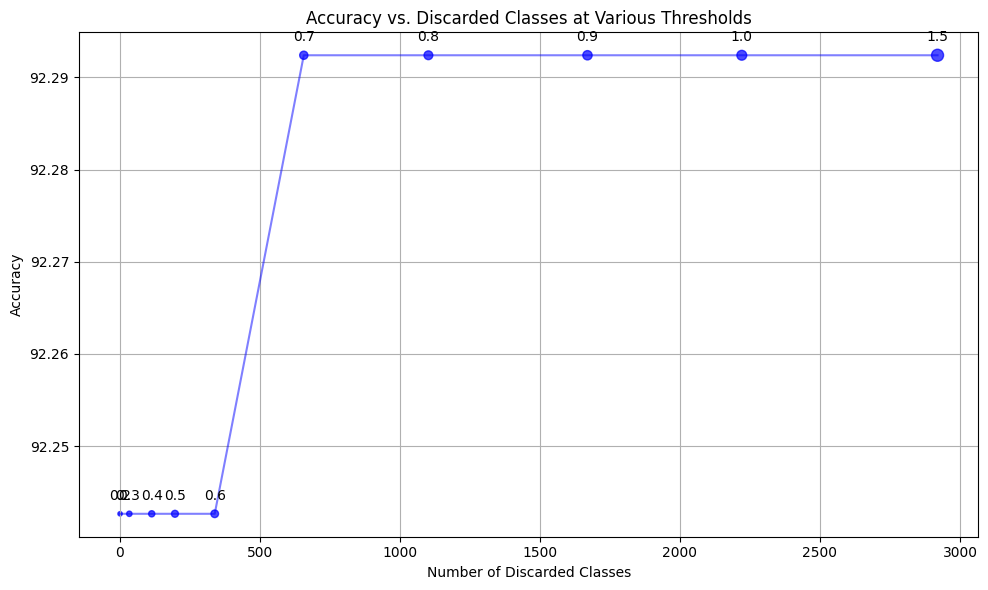

In [ ]:
copied_images_prev = set()  # Track copied image paths
copied_images_dict = {}

disc_classes = []
accuracies = []
thresholds = [1.5, 1.0, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0]

for threshold in thresholds:
    supervector_classes = unique_classes

    front_mask = np.array(["front" in label for label in supervector_classes])
    back_mask = np.array(["right" in label for label in supervector_classes])
    non_back_mask = ~back_mask
    non_back_svs = supervectors[non_back_mask, :]
    front_svs = supervectors[front_mask, :]
    back_svs = supervectors[back_mask, :]

    distances = scipy.spatial.distance.cdist(back_svs, front_svs)

    close_products_mask = np.min(distances, axis=1) < threshold
    close_classes = supervector_classes[back_mask][close_products_mask]

    thres_mask = np.min(distances, axis=1) > threshold

    filtered_supervectors = np.concatenate((non_back_svs, back_svs[thres_mask]), axis=0)
    filtered_sv_classes = np.concatenate(
        (supervector_classes[~back_mask], supervector_classes[back_mask][thres_mask])
    )

    knn = KNeighborsClassifier(n_neighbors=1, metric="euclidean")
    knn.fit(filtered_supervectors, filtered_sv_classes)

    front_test_vectors, front_test_classes = filter_by_face(
        np.array(test_vectors), np.array(test_classes), face="front"
    )
    front_test_mask = np.array(["front" in label for label in test_classes])
    front_test_labelled = np.array(test_labelled)[front_test_mask]

    distances, indices = knn.kneighbors(front_test_vectors)
    predicted_labels = knn.predict(front_test_vectors)
    predicted_upc = np.array([pred.split("_")[1] for pred in predicted_labels])
    gt = np.array([gt.split("_")[1] for gt in front_test_classes])
    correct = predicted_upc == gt
    copied_images_dict[threshold] = []

    incorrect_predictions = [
        (i, gt_name, pred)
        for i, (gt_name, pred) in enumerate(zip(front_test_labelled, predicted_labels))
        if gt_name.split("_")[1] != pred.split("_")[1]
    ]

    print(
        f"threshold {threshold}:",
        np.count_nonzero(correct) / correct.shape[0],
        f"classes: {filtered_sv_classes.shape[0]}, incorrect: {len(incorrect_predictions)}",
    )
    disc_classes.append(len(supervector_classes) - filtered_sv_classes.shape[0])
    accuracies.append(np.count_nonzero(correct) / correct.shape[0])


# Normalize or scale marker sizes based on threshold
marker_sizes = [t * 50 for t in thresholds]  # Adjust the multiplier to taste

plt.figure(figsize=(10, 6))
plt_accuracies = [acc * 100 for acc in accuracies]  # Convert to percentage
plt.scatter(disc_classes, plt_accuracies, s=marker_sizes, c="blue", alpha=0.7)
plt.plot(
    disc_classes, plt_accuracies, color="blue", alpha=0.5
)  # Connect points with a line
plt.xlabel("Number of Discarded Classes")
plt.ylabel("Accuracy")
plt.title("Accuracy vs. Discarded Classes at Various Thresholds")

# Annotate each point with its threshold
for i, threshold in enumerate(thresholds):
    plt.annotate(
        f"{threshold}",
        (disc_classes[i], plt_accuracies[i]),
        textcoords="offset points",
        xytext=(0, 10),
        ha="center",
    )

plt.grid(True)
plt.tight_layout()
plt.show()